<a href="https://colab.research.google.com/github/YutthapoomTh/ColorDetect/blob/main/train_model%20/YOLOv8/YOLOv8_Validation_model_Gun_detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# <font color='#ffca1d'> 🔵 YOLOv8 Validation Model Gun Detection</font>

# Mounting Google Drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

# 🔍 Check Runtime
Check the current runtime environment before Validation the YOLOv8 model.

## 🖥️ Displaying system information

In [ ]:
!cat /etc/*release

DISTRIB_ID=Ubuntu
DISTRIB_RELEASE=22.04
DISTRIB_CODENAME=jammy
DISTRIB_DESCRIPTION="Ubuntu 22.04.3 LTS"
PRETTY_NAME="Ubuntu 22.04.3 LTS"
NAME="Ubuntu"
VERSION_ID="22.04"
VERSION="22.04.3 LTS (Jammy Jellyfish)"
VERSION_CODENAME=jammy
ID=ubuntu
ID_LIKE=debian
HOME_URL="https://www.ubuntu.com/"
SUPPORT_URL="https://help.ubuntu.com/"
BUG_REPORT_URL="https://bugs.launchpad.net/ubuntu/"
PRIVACY_POLICY_URL="https://www.ubuntu.com/legal/terms-and-policies/privacy-policy"
UBUNTU_CODENAME=jammy


## ⚙️ Check CPU Info
Shows CPU details including model, core count, and frequency.

In [ ]:
!cat /proc/cpuinfo

processor	: 0
vendor_id	: GenuineIntel
cpu family	: 6
model		: 79
model name	: Intel(R) Xeon(R) CPU @ 2.20GHz
stepping	: 0
microcode	: 0xffffffff
cpu MHz		: 2199.998
cache size	: 56320 KB
physical id	: 0
siblings	: 2
core id		: 0
cpu cores	: 1
apicid		: 0
initial apicid	: 0
fpu		: yes
fpu_exception	: yes
cpuid level	: 13
wp		: yes
flags		: fpu vme de pse tsc msr pae mce cx8 apic sep mtrr pge mca cmov pat pse36 clflush mmx fxsr sse sse2 ss ht syscall nx pdpe1gb rdtscp lm constant_tsc rep_good nopl xtopology nonstop_tsc cpuid tsc_known_freq pni pclmulqdq ssse3 fma cx16 pcid sse4_1 sse4_2 x2apic movbe popcnt aes xsave avx f16c rdrand hypervisor lahf_lm abm 3dnowprefetch invpcid_single ssbd ibrs ibpb stibp fsgsbase tsc_adjust bmi1 hle avx2 smep bmi2 erms invpcid rtm rdseed adx smap xsaveopt arat md_clear arch_capabilities
bugs		: cpu_meltdown spectre_v1 spectre_v2 spec_store_bypass l1tf mds swapgs taa mmio_stale_data retbleed bhi
bogomips	: 4399.99
clflush size	: 64
cache_alignment	: 64
ad

## Check Python Version
Verifies the Python version being used in the current environment.

In [ ]:
!python --version

Python 3.10.12


## Check RAM Size
Detects the total available RAM. If the environment has 20 GB or more, it indicates a high-RAM runtime — useful for training large models or using larger batch sizes.

In [ ]:
from psutil import virtual_memory
ram_gb = virtual_memory().total / 1e9
print('Your runtime has {:.1f} gigabytes of available RAM\n'.format(ram_gb))

if ram_gb < 20:
  print('Not using a high-RAM runtime')
else:
  print('You are using a high-RAM runtime!')

## Check GPU Availability
Checks whether a GPU is connected and accessible. If so, it prints GPU

In [ ]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)

Thu Oct 17 07:49:39 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   57C    P8              11W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

# 📥 Download Dataset From Drive
- This section shows how to automatically download and organize the dataset from Google Drive using gdown.

## 🔧 Reinstall gdown

In [ ]:
%pip uninstall -y gdown
%pip install --upgrade --no-cache-dir gdown

Found existing installation: gdown 5.2.0
Uninstalling gdown-5.2.0:
  Successfully uninstalled gdown-5.2.0


## 📁 Prepare Dataset Directory

In [ ]:
from pathlib import Path

dataset_dir = Path('./dataset')
dataset_dir.mkdir(exist_ok=True)

## 🌐 Download and Extract the Validation Dataset
Download the dataset ZIP file from Google Drive and extract it into the dataset directory.

In [ ]:
import gdown

url = "https://drive.google.com/file/d/1cmwQ4SPk0E5dk-T0_NU_p11QLwfCQMjm/view?usp=drive_link"
output_path = 'val.zip'

gdown.download(url, output_path, quiet=False,fuzzy=True)

# Unzip File
!unzip "/content/val.zip" -d "/content/dataset/images/"

#!sudo rm /content/images.zip
print("\n__________ Completed __________")

In [ ]:
!ls /content/dataset/images/

val


## 🔢 Check Number of Files in Val set

Verify that your validation folders have the expected files.

In [ ]:
import os

source_dir="/content/dataset/images/val/"

for i, filename in enumerate(os.listdir(source_dir)):
    print(i+1,filename)

print("\n__________ Completed __________")

# 🌐 Download and Extract Labels Dataset

In [ ]:
import gdown

url = "https://drive.google.com/file/d/1gCnTuFL2AJSXjE78PtOcFa6l1a8X-D5v/view?usp=drive_link"
output_path = 'labels.zip'

gdown.download(url, output_path, quiet=False,fuzzy=True)

!unzip "/content/labels.zip" -d "/content/dataset/"

#!sudo rm /content/labels.zip
print("\n__________ Completed __________")

# **📝 Make `gun_dataset.yaml` File**
- Create a dataset configuration file for training the YOLOv8 model with custom gun classes.
- 📂 This file tells YOLOv8 where the training and validation images are, how many classes (nc), and what the class names are.

In [ ]:
import os
Home = os.getcwd()
print(Home)

/content


In [ ]:
f1 = open(f'{Home}/dataset/gun_dataset.yaml','w',encoding='UTF-8')

f1.write(f'train: {Home}/dataset/images/train\n')
f1.write(f'val: {Home}/dataset/images/val\n')
f1.write('\n')
f1.write('nc: 3\n')
f1.write("names: ['Handgun','Rifle','Shotgun']")

f1.close()

In [ ]:
!cat /content/dataset/gun_dataset.yaml

train: /content/dataset/images/train
val: /content/dataset/images/val

nc: 3
names: ['Handgun','Rifle','Shotgun']

# ⚙️ Install YOLOv8 and Pytorch

In [ ]:
%pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 870.5/870.5 kB 23.4 MB/s eta 0:00:00


In [ ]:
%pip install torch torchvision torchaudio

# ✅ Verify Install
Ensure that the YOLOv8 and PyTorch installations are successful.

## 🔍 Verify YOLO Installation

In [ ]:
# Verify YOLO
import ultralytics
ultralytics.checks()

Ultralytics 8.3.15 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 33.4/235.7 GB disk)


## 🔍 Verify Torch and Torchvision Installation

In [ ]:
# Verify Torch
import torch

print("\ntorch version = ", torch.__version__)
print("CUDA Available = ", torch.cuda.is_available())
print("CUDA Device = ", torch.cuda.get_device_name())

In [ ]:
import torchvision
print("torchvision =", torchvision.__version__)

# Test Model – YOLOv8 Pretrained
Run a quick test using a pretrained YOLOv8 model and a sample image.

In [ ]:
import gdown

# 🔽 Download a sample image
url = "https://drive.google.com/file/d/1EYpP0-oA5lr-BEvoeZMRbiTHcbK5OtPA/view?usp=drive_link"
output_path = 'city_scene_image.png'
gdown.download(url, output_path, quiet=False,fuzzy=True)

Downloading...
From: https://drive.google.com/uc?id=1EYpP0-oA5lr-BEvoeZMRbiTHcbK5OtPA
To: /content/city_scene_image.png
100%|██████████| 705k/705k [00:00<00:00, 45.8MB/s]


'city_scene_image.png'

100%|██████████| 6.25M/6.25M [00:00<00:00, 64.2MB/s]



image 1/1 /content/city_scene_image.png: 384x640 28 persons, 2 buss, 2 umbrellas, 2 potted plants, 213.9ms
Speed: 23.1ms preprocess, 213.9ms inference, 1209.2ms postprocess per image at shape (1, 3, 384, 640)


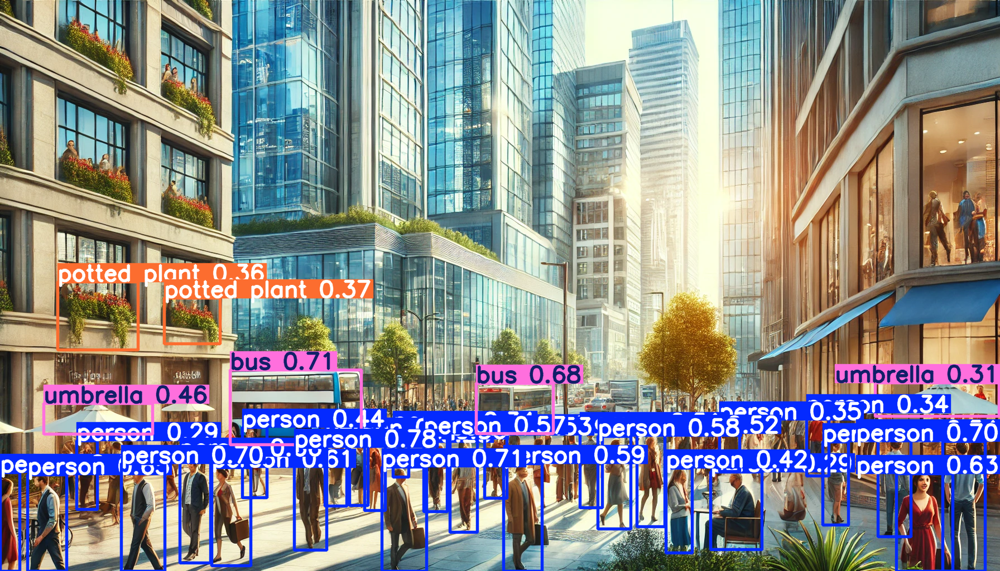


image 1/1 /content/city_scene_image.png: 384x640 28 persons, 2 buss, 2 umbrellas, 2 potted plants, 8.7ms
Speed: 3.3ms preprocess, 8.7ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


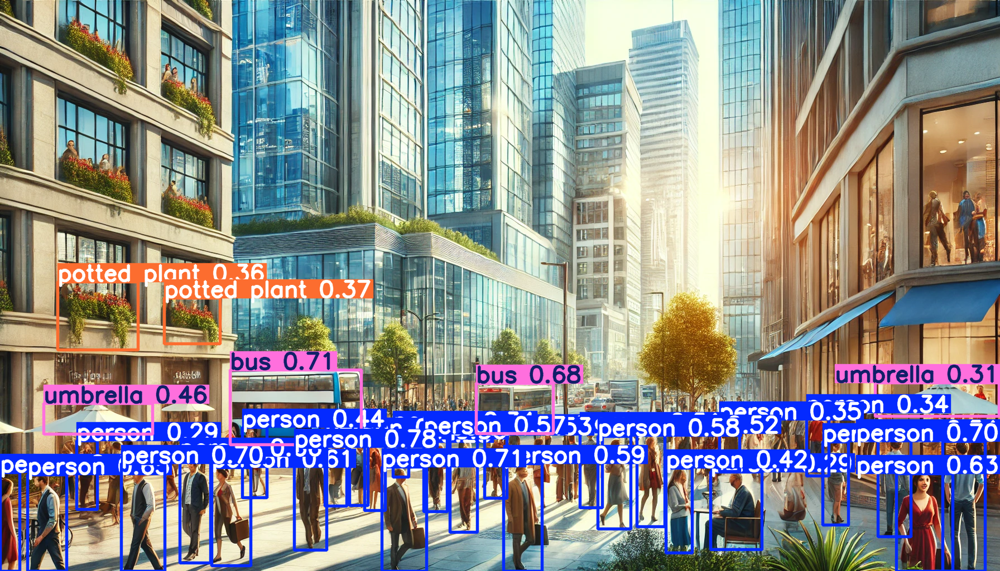

In [ ]:
from ultralytics import YOLO

# Load a model
model = YOLO("yolov8n.pt")

# Test predict on an image
results = model("/content/city_scene_image.png")
results[0].show()

# 🎯 YOLOv8 Gun Detection – Model Validation
- The validation uses the `args.yaml` file to display the configuration used during training.
- This notebook validates each YOLOv8n model trained to detect guns and show metrics Precision, Recall, map50, map75, map50-95, F1 score and File Size.


## Model 00 - Default parameter

In [ ]:
# Parameter
!cat /content/drive/MyDrive/Project_GunDetection/01-YOLOv8/YOLO8n_Gun_detection_Trained/00-Train_100_epoch_batch16_default/args.yaml

task: detect
mode: train
model: yolov8n.pt
data: /content/dataset/Gun_Dataset/gun_dataset.yaml
epochs: 100
patience: 50
batch: 16
imgsz: 640
save: true
save_period: -1
cache: false
device: 0
workers: 8
project: /content/drive/MyDrive/Gun_Detection/save_models_yolov8-0-43
name: Train_100_epoch_batch_default
exist_ok: false
pretrained: false
optimizer: SGD
verbose: true
seed: 0
deterministic: true
single_cls: false
image_weights: false
rect: false
cos_lr: false
close_mosaic: 10
resume: false
min_memory: false
overlap_mask: true
mask_ratio: 4
dropout: false
val: true
split: val
save_json: false
save_hybrid: false
conf: 0.001
iou: 0.7
max_det: 300
half: false
dnn: false
plots: true
source: ultralytics/assets/
show: false
save_txt: false
save_conf: false
save_crop: false
hide_labels: false
hide_conf: false
vid_stride: 1
line_thickness: 3
visualize: false
augment: false
agnostic_nms: false
classes: null
retina_masks: false
boxes: true
format: torchscript
keras: false
optimize: false
int8: fa


image 1/1 /content/drive/MyDrive/Project_GunDetection/00-Gun_Dataset/test_handgun.png: 480x640 1 Handgun, 59.3ms
Speed: 3.4ms preprocess, 59.3ms inference, 5.3ms postprocess per image at shape (1, 3, 480, 640)


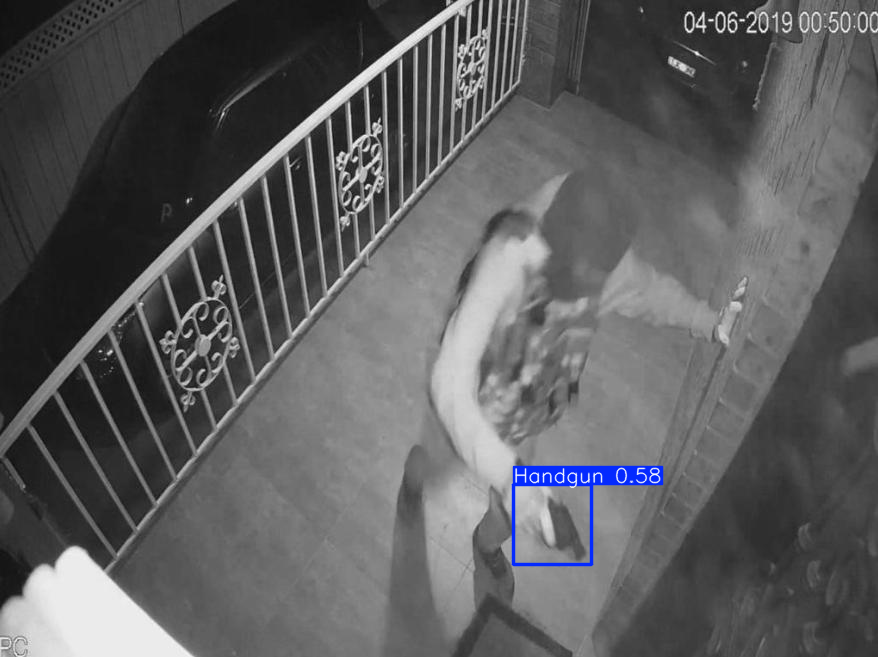




image 1/1 /content/dataset/images/val/ai_gen_handgun_309-flip.jpg: 640x640 2 Handguns, 10.2ms
Speed: 8.9ms preprocess, 10.2ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


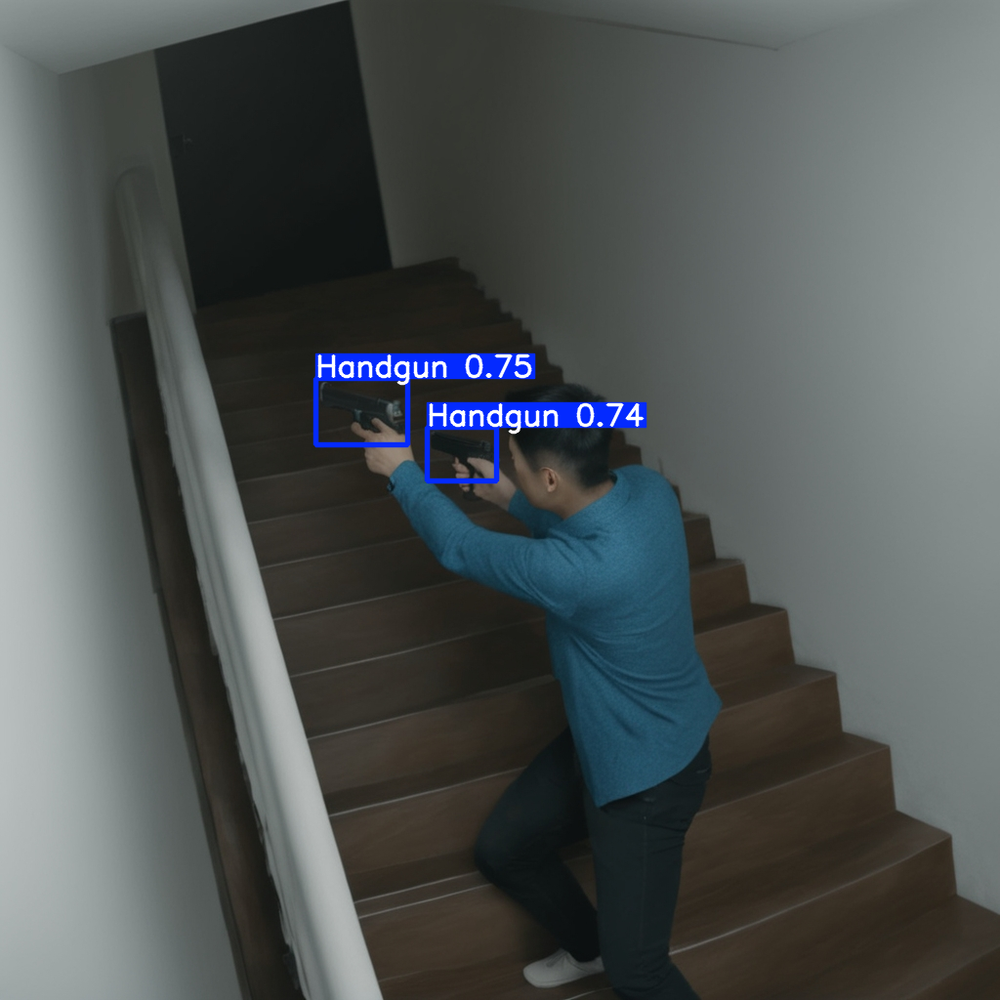



Ultralytics 8.3.15 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)


100%|██████████| 755k/755k [00:00<00:00, 41.1MB/s]
val: Scanning /content/dataset/labels/val... 2649 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2649/2649 [00:03<00:00, 765.85it/s]


val: New cache created: /content/dataset/labels/val.cache


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [01:04<00:00,  1.55s/it]


                   all       2649       2797      0.988      0.921      0.958      0.761
               Handgun        929        959      0.981      0.905      0.949      0.727
                 Rifle        737        805      0.993      0.907      0.951      0.756
               Shotgun       1000       1033       0.99      0.952      0.974      0.799
Speed: 0.6ms preprocess, 2.8ms inference, 0.0ms loss, 1.4ms postprocess per image
Results saved to runs/detect/val


Precision = 0.988
Recall = 0.9212
map50 = 0.958
map75 = 0.8746
map50-95 = 0.761
F1 score = 0.9534
File Size 5.93 MB


a list contains map50-95 of each category : 
	Handgun = 0.7273  
	Rifle = 0.7563 
	Shotgun = 0.7994

__________ Completed __________


In [ ]:
import os
from ultralytics import YOLO

model_path = "/content/drive/MyDrive/Project_GunDetection/01-YOLOv8/YOLO8n_Gun_detection_Trained/00-Train_100_epoch_batch16_default/weights/best.pt"

# Load a model
model = YOLO(model_path)

# Test predict on an image
results1 = model("/content/drive/MyDrive/Project_GunDetection/00-Gun_Dataset/test_handgun.png", conf=0.5)
results1[0].show()
print('\n')
results2 = model("dataset/images/val/ai_gen_handgun_309-flip.jpg", conf=0.5)
results2[0].show()

print("\n")
# Validate the model
metrics = model.val(iou=0.5, conf=0.50, data="/content/dataset/gun_dataset.yaml", device=0, batch=64)  # no arguments needed, dataset and settings remembered

print("\n")
p = round(metrics.results_dict['metrics/precision(B)'], 4)
r = round(metrics.results_dict['metrics/recall(B)'], 4)
f1 = round(2*p*r/(p+r), 4)

print("Precision =", p)
print("Recall =", r)
print(f"map50 = {round(metrics.box.map50, 4)}")  # map50
print(f"map75 = {round(metrics.box.map75, 4)}")  # map75
print(f"map50-95 = {round(metrics.box.map, 4)}")  # map50-95
print("F1 score =", f1)

file_stats = os.stat(model_path)
print(f'File Size {round(file_stats.st_size / (1024 * 1024), 2)} MB')

print("\n")
print(f"a list contains map50-95 of each category : \n\tHandgun = {round(metrics.box.maps[0], 4)}  \n\tRifle = {round(metrics.box.maps[1], 4)} \n\tShotgun = {round(metrics.box.maps[2], 4)}")

print("\n__________ Completed __________")

# Model 01

In [ ]:
# Parameter
!cat /content/drive/MyDrive/Project_GunDetection/01-YOLOv8/YOLO8n_Gun_detection_Trained/01-Train_100_epoch_batch_32/args.yaml

task: detect
mode: train
model: yolov8n.pt
data: /content/dataset/Gun_Dataset/gun_dataset.yaml
epochs: 100
patience: 50
batch: 32
imgsz: 640
save: true
save_period: -1
cache: false
device: 0
workers: 8
project: /content/drive/MyDrive/Gun_Detection/save_models_yolov8-0-43
name: Train_100_epoch_batch_32
exist_ok: false
pretrained: false
optimizer: SGD
verbose: true
seed: 0
deterministic: true
single_cls: false
image_weights: false
rect: false
cos_lr: false
close_mosaic: 10
resume: false
min_memory: false
overlap_mask: true
mask_ratio: 4
dropout: false
val: true
split: val
save_json: false
save_hybrid: false
conf: 0.001
iou: 0.7
max_det: 300
half: false
dnn: false
plots: true
source: ultralytics/assets/
show: false
save_txt: false
save_conf: false
save_crop: false
hide_labels: false
hide_conf: false
vid_stride: 1
line_thickness: 3
visualize: false
augment: false
agnostic_nms: false
classes: null
retina_masks: false
boxes: true
format: torchscript
keras: false
optimize: false
int8: false
d


image 1/1 /content/drive/MyDrive/Project_GunDetection/00-Gun_Dataset/test_handgun.png: 480x640 1 Handgun, 33.2ms
Speed: 2.7ms preprocess, 33.2ms inference, 672.8ms postprocess per image at shape (1, 3, 480, 640)


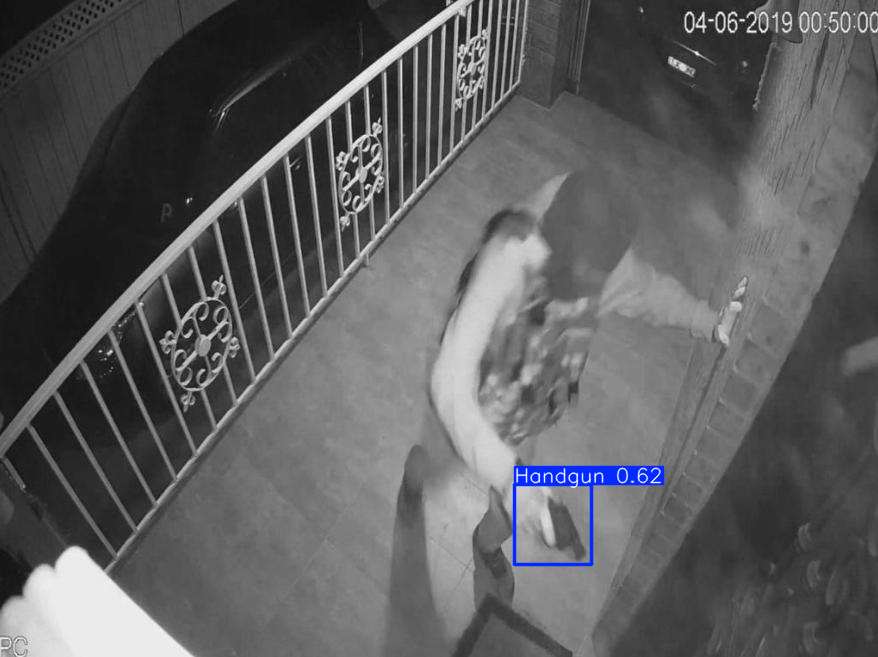




image 1/1 /content/dataset/images/val/ai_gen_handgun_309-flip.jpg: 640x640 2 Handguns, 9.6ms
Speed: 4.8ms preprocess, 9.6ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


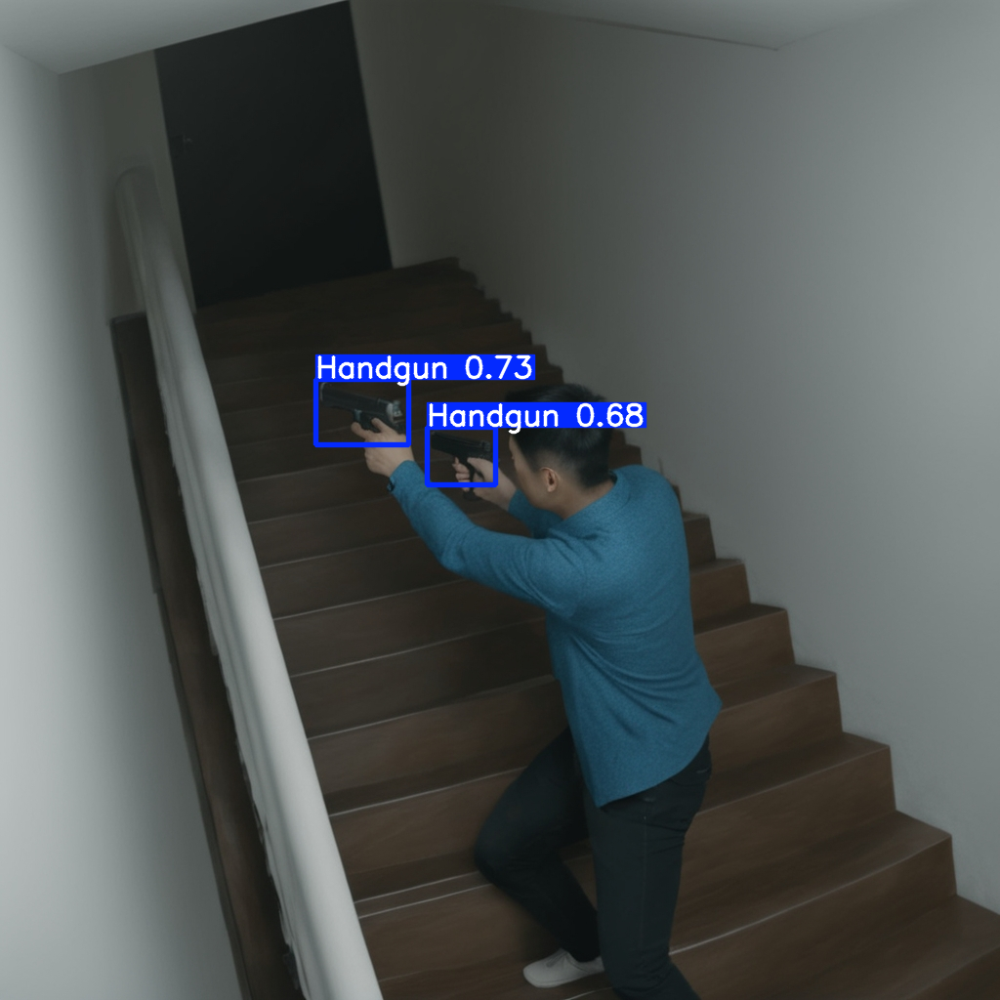



Ultralytics 8.3.15 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)


val: Scanning /content/dataset/labels/val.cache... 2649 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2649/2649 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [01:19<00:00,  1.89s/it]


                   all       2649       2797      0.989      0.921      0.958      0.761
               Handgun        929        959      0.983      0.909       0.95      0.726
                 Rifle        737        805      0.989      0.909      0.952      0.759
               Shotgun       1000       1033      0.994      0.946      0.971      0.798
Speed: 0.3ms preprocess, 2.8ms inference, 0.0ms loss, 1.6ms postprocess per image
Results saved to runs/detect/val3


Precision = 0.9887
Recall = 0.9215
map50 = 0.9577
map75 = 0.8672
map50-95 = 0.7609
F1 score = 0.9539
File Size 5.93 MB


a list contains map50-95 of each category : 
	Handgun = 0.7262  
	Rifle = 0.7585 
	Shotgun = 0.7981

__________ Completed __________


In [ ]:
import os
from ultralytics import YOLO

model_path = "/content/drive/MyDrive/Project_GunDetection/01-YOLOv8/YOLO8n_Gun_detection_Trained/01-Train_100_epoch_batch_32/weights/best.pt"

# Load a model
model = YOLO(model_path)

# Test predict on an image
results1 = model("/content/drive/MyDrive/Project_GunDetection/00-Gun_Dataset/test_handgun.png", conf=0.5)
results1[0].show()
print('\n')
results2 = model("dataset/images/val/ai_gen_handgun_309-flip.jpg", conf=0.5)
results2[0].show()

print("\n")
# Validate the model
metrics = model.val(iou=0.5, conf=0.50, data="/content/dataset/gun_dataset.yaml", device=0, batch=64)  # no arguments needed, dataset and settings remembered

print("\n")
p = round(metrics.results_dict['metrics/precision(B)'], 4)
r = round(metrics.results_dict['metrics/recall(B)'], 4)
f1 = round(2*p*r/(p+r), 4)

print("Precision =", p)
print("Recall =", r)
print(f"map50 = {round(metrics.box.map50, 4)}")  # map50
print(f"map75 = {round(metrics.box.map75, 4)}")  # map75
print(f"map50-95 = {round(metrics.box.map, 4)}")  # map50-95
print("F1 score =", f1)

file_stats = os.stat(model_path)
print(f'File Size {round(file_stats.st_size / (1024 * 1024), 2)} MB')

print("\n")
print(f"a list contains map50-95 of each category : \n\tHandgun = {round(metrics.box.maps[0], 4)}  \n\tRifle = {round(metrics.box.maps[1], 4)} \n\tShotgun = {round(metrics.box.maps[2], 4)}")

print("\n__________ Completed __________")

## Model 02

In [ ]:
# Parameter
!cat /content/drive/MyDrive/Project_GunDetection/01-YOLOv8/YOLO8n_Gun_detection_Trained/02-Train_100_epoch_batch_64/args.yaml

task: detect
mode: train
model: yolov8n.pt
data: /content/dataset/Gun_Dataset/gun_dataset.yaml
epochs: 100
patience: 50
batch: 64
imgsz: 640
save: true
save_period: -1
cache: false
device: 0
workers: 8
project: /content/drive/MyDrive/Gun_Detection/save_models_yolov8-0-43
name: Train_100_epoch_batch_64
exist_ok: false
pretrained: false
optimizer: SGD
verbose: true
seed: 0
deterministic: true
single_cls: false
image_weights: false
rect: false
cos_lr: false
close_mosaic: 10
resume: false
min_memory: false
overlap_mask: true
mask_ratio: 4
dropout: false
val: true
split: val
save_json: false
save_hybrid: false
conf: 0.001
iou: 0.7
max_det: 300
half: false
dnn: false
plots: true
source: ultralytics/assets/
show: false
save_txt: false
save_conf: false
save_crop: false
hide_labels: false
hide_conf: false
vid_stride: 1
line_thickness: 3
visualize: false
augment: false
agnostic_nms: false
classes: null
retina_masks: false
boxes: true
format: torchscript
keras: false
optimize: false
int8: false
d


image 1/1 /content/drive/MyDrive/Project_GunDetection/00-Gun_Dataset/test_handgun.png: 480x640 1 Handgun, 8.8ms
Speed: 2.1ms preprocess, 8.8ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)


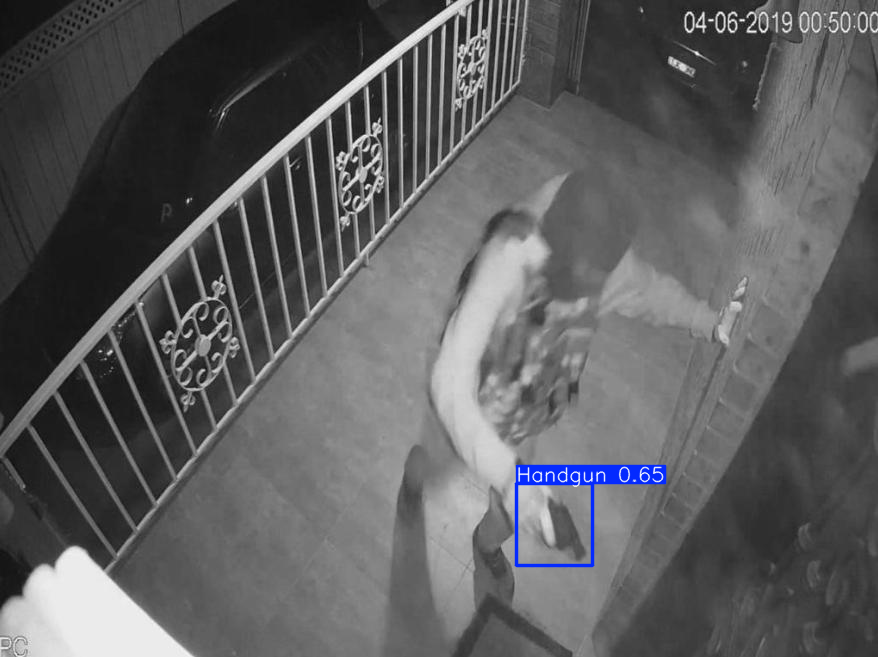




image 1/1 /content/dataset/images/val/ai_gen_handgun_309-flip.jpg: 640x640 2 Handguns, 15.1ms
Speed: 4.3ms preprocess, 15.1ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


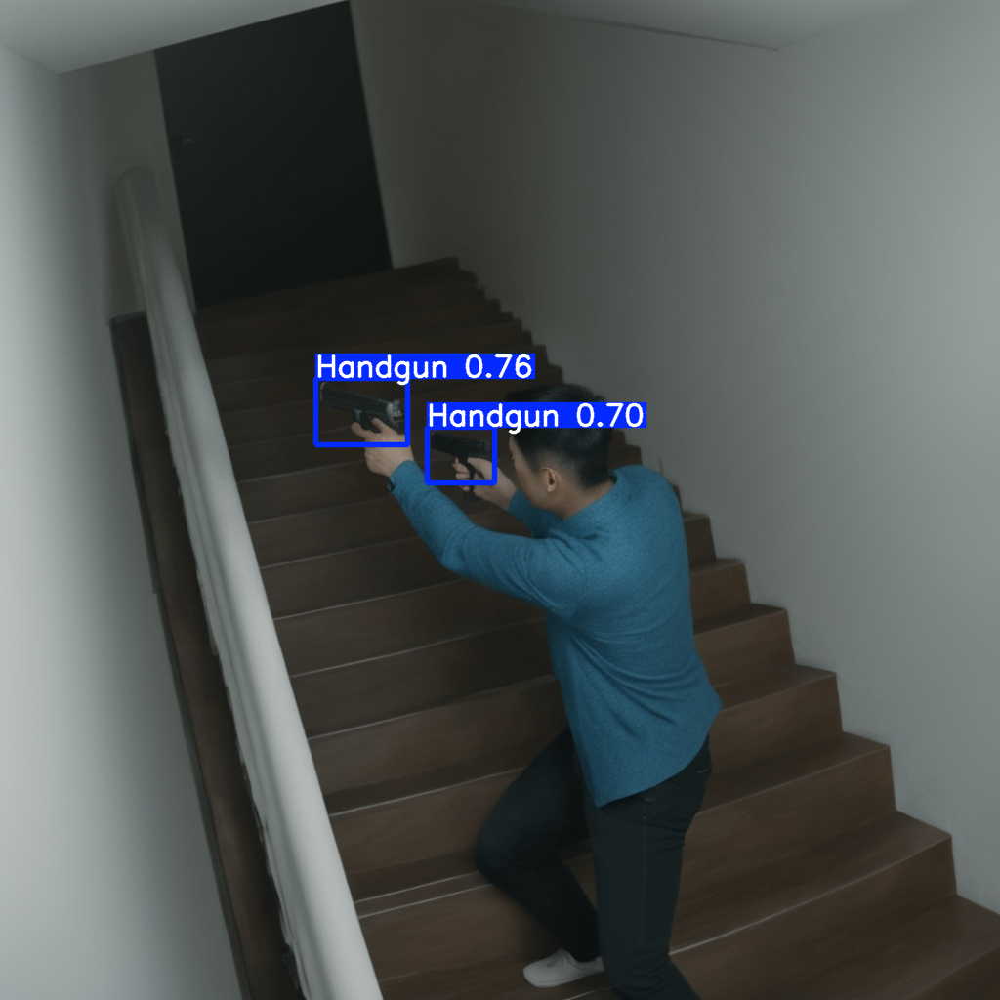



Ultralytics 8.3.15 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)


val: Scanning /content/dataset/labels/val.cache... 2649 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2649/2649 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [01:05<00:00,  1.55s/it]


                   all       2649       2797      0.989      0.933      0.964      0.765
               Handgun        929        959       0.98       0.92      0.955      0.729
                 Rifle        737        805      0.995      0.919      0.959      0.762
               Shotgun       1000       1033      0.993      0.959      0.978      0.804
Speed: 0.2ms preprocess, 2.8ms inference, 0.0ms loss, 1.5ms postprocess per image
Results saved to runs/detect/val4


Precision = 0.9892
Recall = 0.9328
map50 = 0.964
map75 = 0.8705
map50-95 = 0.7647
F1 score = 0.9602
File Size 5.94 MB


a list contains map50-95 of each category : 
	Handgun = 0.7289  
	Rifle = 0.7616 
	Shotgun = 0.8036

__________ Completed __________


In [ ]:
import os
from ultralytics import YOLO

model_path = "/content/drive/MyDrive/Project_GunDetection/01-YOLOv8/YOLO8n_Gun_detection_Trained/02-Train_100_epoch_batch_64/weights/best.pt"

# Load a model
model = YOLO(model_path)

# Test predict on an image
results1 = model("/content/drive/MyDrive/Project_GunDetection/00-Gun_Dataset/test_handgun.png", conf=0.5)
results1[0].show()
print('\n')
results2 = model("dataset/images/val/ai_gen_handgun_309-flip.jpg", conf=0.5)
results2[0].show()

print("\n")
# Validate the model
metrics = model.val(iou=0.5, conf=0.50, data="/content/dataset/gun_dataset.yaml", device=0, batch=64)  # no arguments needed, dataset and settings remembered

print("\n")
p = round(metrics.results_dict['metrics/precision(B)'], 4)
r = round(metrics.results_dict['metrics/recall(B)'], 4)
f1 = round(2*p*r/(p+r), 4)

print("Precision =", p)
print("Recall =", r)
print(f"map50 = {round(metrics.box.map50, 4)}")  # map50
print(f"map75 = {round(metrics.box.map75, 4)}")  # map75
print(f"map50-95 = {round(metrics.box.map, 4)}")  # map50-95
print("F1 score =", f1)

file_stats = os.stat(model_path)
print(f'File Size {round(file_stats.st_size / (1024 * 1024), 2)} MB')

print("\n")
print(f"a list contains map50-95 of each category : \n\tHandgun = {round(metrics.box.maps[0], 4)}  \n\tRifle = {round(metrics.box.maps[1], 4)} \n\tShotgun = {round(metrics.box.maps[2], 4)}")

print("\n__________ Completed __________")

# Model 03

In [ ]:
# Parameter
!cat /content/drive/MyDrive/Project_GunDetection/01-YOLOv8/YOLO8n_Gun_detection_Trained/03-Train_batch64_optimizer_AdamW_lr0_0-001/args.yaml

task: detect
mode: train
model: /content/drive/MyDrive/Gun_Detection/save_models_yolov8-0-43/Train_100_epoch_batch_64/weights/best.pt
data: /content/dataset/Gun_Dataset/gun_dataset.yaml
epochs: 100
patience: 50
batch: 64
imgsz: 640
save: true
save_period: -1
cache: false
device: 0
workers: 8
project: save_models_yolov8-0-43
name: 'Train_batch64_optimizer_AdamW_lr0_0-001 '
exist_ok: false
pretrained: false
optimizer: AdamW
verbose: true
seed: 0
deterministic: true
single_cls: false
image_weights: false
rect: false
cos_lr: false
close_mosaic: 10
resume: false
min_memory: false
overlap_mask: true
mask_ratio: 4
dropout: false
val: true
split: val
save_json: false
save_hybrid: false
conf: 0.001
iou: 0.7
max_det: 300
half: false
dnn: false
plots: true
source: ultralytics/assets/
show: false
save_txt: false
save_conf: false
save_crop: false
hide_labels: false
hide_conf: false
vid_stride: 1
line_thickness: 3
visualize: false
augment: false
agnostic_nms: false
classes: null
retina_masks: false



image 1/1 /content/drive/MyDrive/Project_GunDetection/00-Gun_Dataset/test_handgun.png: 480x640 1 Handgun, 53.3ms
Speed: 4.3ms preprocess, 53.3ms inference, 1052.8ms postprocess per image at shape (1, 3, 480, 640)


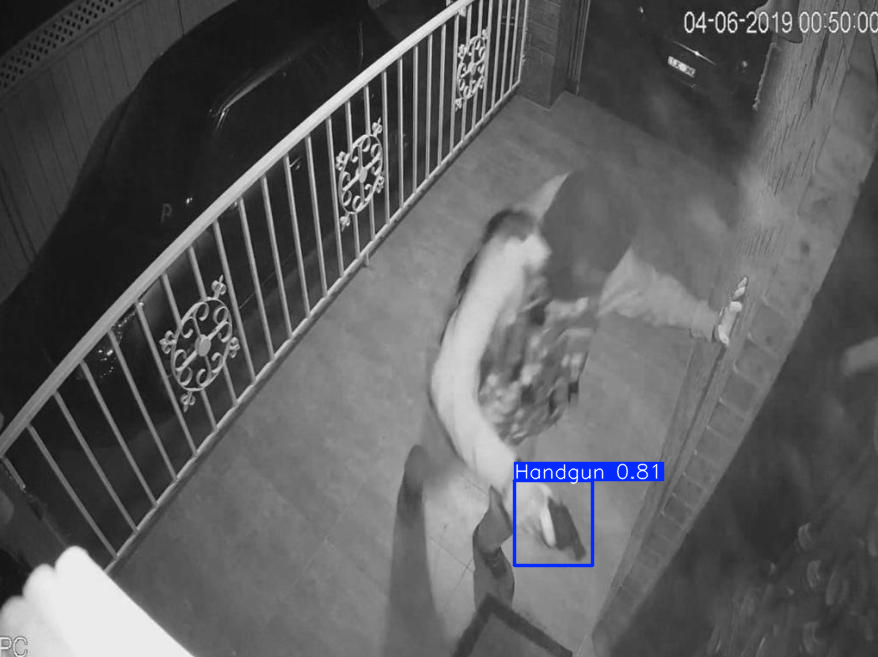




image 1/1 /content/dataset/images/val/ai_gen_handgun_309-flip.jpg: 640x640 2 Handguns, 20.6ms
Speed: 7.7ms preprocess, 20.6ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


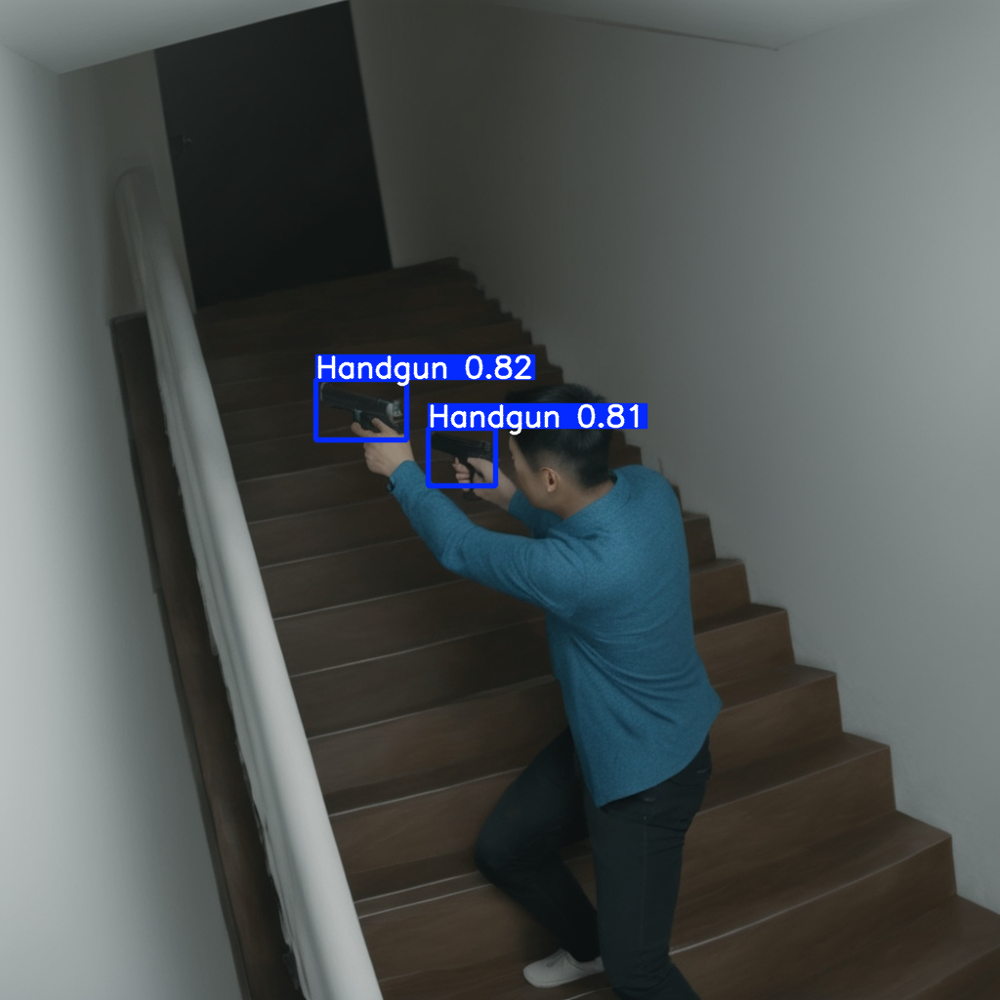



Ultralytics 8.3.15 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)


val: Scanning /content/dataset/labels/val.cache... 2649 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2649/2649 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [01:08<00:00,  1.64s/it]


                   all       2649       2797      0.986      0.958      0.976      0.782
               Handgun        929        959      0.976      0.945      0.968      0.739
                 Rifle        737        805      0.991      0.947      0.972      0.779
               Shotgun       1000       1033       0.99      0.982      0.989      0.827
Speed: 0.2ms preprocess, 2.8ms inference, 0.0ms loss, 1.5ms postprocess per image
Results saved to runs/detect/val10


Precision = 0.9858
Recall = 0.9576
map50 = 0.9765
map75 = 0.8929
map50-95 = 0.7817
F1 score = 0.9715
File Size 5.94 MB


a list contains map50-95 of each category : 
	Handgun = 0.7389  
	Rifle = 0.7789 
	Shotgun = 0.8273

__________ Completed __________


In [ ]:
import os
from ultralytics import YOLO

model_path = "/content/drive/MyDrive/Project_GunDetection/01-YOLOv8/YOLO8n_Gun_detection_Trained/03-Train_batch64_optimizer_AdamW_lr0_0-001/weights/best.pt"

# Load a model
model = YOLO(model_path)

# Test predict on an image
results1 = model("/content/drive/MyDrive/Project_GunDetection/00-Gun_Dataset/test_handgun.png", conf=0.5)
results1[0].show()
print('\n')
results2 = model("dataset/images/val/ai_gen_handgun_309-flip.jpg", conf=0.5)
results2[0].show()

print("\n")
# Validate the model
metrics = model.val(iou=0.5, conf=0.50, data="/content/dataset/gun_dataset.yaml", device=0, batch=64)  # no arguments needed, dataset and settings remembered

print("\n")
p = round(metrics.results_dict['metrics/precision(B)'], 4)
r = round(metrics.results_dict['metrics/recall(B)'], 4)
f1 = round(2*p*r/(p+r), 4)

print("Precision =", p)
print("Recall =", r)
print(f"map50 = {round(metrics.box.map50, 4)}")  # map50
print(f"map75 = {round(metrics.box.map75, 4)}")  # map75
print(f"map50-95 = {round(metrics.box.map, 4)}")  # map50-95
print("F1 score =", f1)

file_stats = os.stat(model_path)
print(f'File Size {round(file_stats.st_size / (1024 * 1024), 2)} MB')

print("\n")
print(f"a list contains map50-95 of each category : \n\tHandgun = {round(metrics.box.maps[0], 4)}  \n\tRifle = {round(metrics.box.maps[1], 4)} \n\tShotgun = {round(metrics.box.maps[2], 4)}")

print("\n__________ Completed __________")

# Model 04

In [ ]:
# Parameter
!cat /content/drive/MyDrive/Project_GunDetection/01-YOLOv8/YOLO8n_Gun_detection_Trained/04-Train_batch64_optimizer_AdamW_lr0_0-001_imgsz_640_weight_decay_0_0005/args.yaml

task: detect
mode: train
model: best.pt
data: /content/dataset/gun_dataset.yaml
epochs: 100
patience: 50
batch: 64
imgsz: 640
save: true
save_period: -1
cache: false
device: 0
workers: 8
project: /content/drive/MyDrive/Gun_Detection/save_models_yolov8-0-43
name: Train_batch64_optimizer_AdamW_lr0_0-001_imgsz_640_weight_decay_0_0005
exist_ok: false
pretrained: false
optimizer: AdamW
verbose: true
seed: 0
deterministic: true
single_cls: false
image_weights: false
rect: false
cos_lr: false
close_mosaic: 10
resume: false
min_memory: false
overlap_mask: true
mask_ratio: 4
dropout: false
val: true
split: val
save_json: false
save_hybrid: false
conf: 0.001
iou: 0.7
max_det: 300
half: false
dnn: false
plots: true
source: ultralytics/assets/
show: false
save_txt: false
save_conf: false
save_crop: false
hide_labels: false
hide_conf: false
vid_stride: 1
line_thickness: 3
visualize: false
augment: false
agnostic_nms: false
classes: null
retina_masks: false
boxes: true
format: torchscript
keras: fal


image 1/1 /content/drive/MyDrive/Project_GunDetection/00-Gun_Dataset/test_handgun.png: 480x640 1 Handgun, 7.6ms
Speed: 2.1ms preprocess, 7.6ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


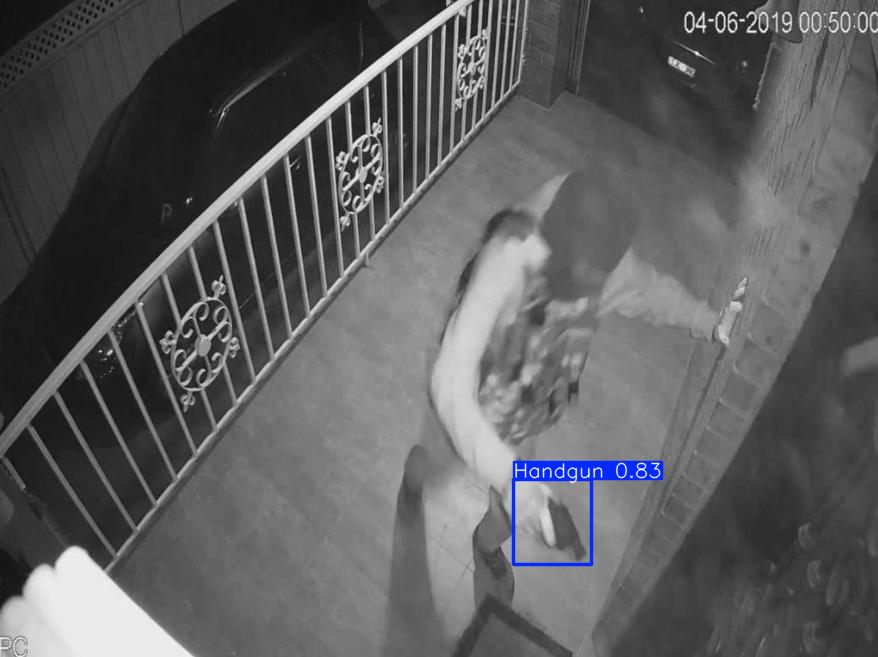




image 1/1 /content/dataset/images/val/ai_gen_handgun_309-flip.jpg: 640x640 2 Handguns, 10.2ms
Speed: 4.4ms preprocess, 10.2ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


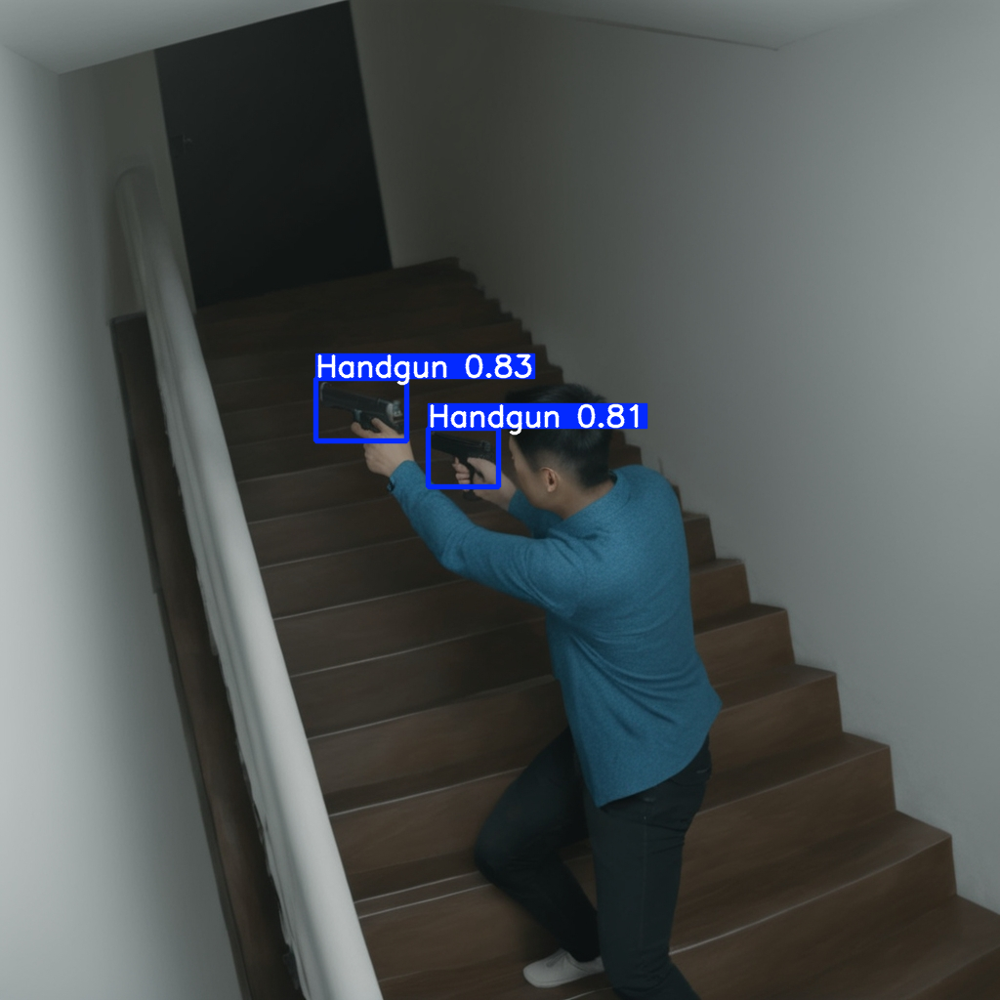



Ultralytics 8.3.15 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)


val: Scanning /content/dataset/labels/val.cache... 2649 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2649/2649 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [01:09<00:00,  1.66s/it]


                   all       2649       2797      0.988      0.964       0.98      0.781
               Handgun        929        959      0.982      0.957      0.974      0.737
                 Rifle        737        805      0.991       0.95      0.974      0.778
               Shotgun       1000       1033       0.99      0.985      0.991      0.828
Speed: 0.2ms preprocess, 2.7ms inference, 0.0ms loss, 1.6ms postprocess per image
Results saved to runs/detect/val6


Precision = 0.9877
Recall = 0.9643
map50 = 0.9796
map75 = 0.8932
map50-95 = 0.7812
F1 score = 0.9759
File Size 5.94 MB


a list contains map50-95 of each category : 
	Handgun = 0.7373  
	Rifle = 0.7782 
	Shotgun = 0.8282

__________ Completed __________


In [ ]:
import os
from ultralytics import YOLO

model_path = "/content/drive/MyDrive/Project_GunDetection/01-YOLOv8/YOLO8n_Gun_detection_Trained/04-Train_batch64_optimizer_AdamW_lr0_0-001_imgsz_640_weight_decay_0_0005/weights/best.pt"

# Load a model
model = YOLO(model_path)

# Test predict on an image
results1 = model("/content/drive/MyDrive/Project_GunDetection/00-Gun_Dataset/test_handgun.png", conf=0.5)
results1[0].show()
print('\n')
results2 = model("dataset/images/val/ai_gen_handgun_309-flip.jpg", conf=0.5)
results2[0].show()

print("\n")
# Validate the model
metrics = model.val(iou=0.5, conf=0.50, data="/content/dataset/gun_dataset.yaml", device=0, batch=64)  # no arguments needed, dataset and settings remembered

print("\n")
p = round(metrics.results_dict['metrics/precision(B)'], 4)
r = round(metrics.results_dict['metrics/recall(B)'], 4)
f1 = round(2*p*r/(p+r), 4)

print("Precision =", p)
print("Recall =", r)
print(f"map50 = {round(metrics.box.map50, 4)}")  # map50
print(f"map75 = {round(metrics.box.map75, 4)}")  # map75
print(f"map50-95 = {round(metrics.box.map, 4)}")  # map50-95
print("F1 score =", f1)

file_stats = os.stat(model_path)
print(f'File Size {round(file_stats.st_size / (1024 * 1024), 2)} MB')

print("\n")
print(f"a list contains map50-95 of each category : \n\tHandgun = {round(metrics.box.maps[0], 4)}  \n\tRifle = {round(metrics.box.maps[1], 4)} \n\tShotgun = {round(metrics.box.maps[2], 4)}")

print("\n__________ Completed __________")

# Model 05

In [ ]:
# Parameter
!cat /content/drive/MyDrive/Project_GunDetection/01-YOLOv8/YOLO8n_Gun_detection_Trained/05-Train_batch64_optimizer_AdamW_lr0_0-001_imgsz_640_momentum_0_8433/args.yaml

task: detect
mode: train
model: best.pt
data: /content/dataset/gun_dataset.yaml
epochs: 100
patience: 50
batch: 64
imgsz: 640
save: true
save_period: -1
cache: false
device: 0
workers: 8
project: /content/drive/MyDrive/Gun_Detection/save_models_yolov8-0-43
name: Train_batch64_optimizer_AdamW_lr0_0-001_imgsz_640_momentum_0_8433
exist_ok: false
pretrained: false
optimizer: AdamW
verbose: true
seed: 0
deterministic: true
single_cls: false
image_weights: false
rect: false
cos_lr: false
close_mosaic: 10
resume: false
min_memory: false
overlap_mask: true
mask_ratio: 4
dropout: false
val: true
split: val
save_json: false
save_hybrid: false
conf: 0.001
iou: 0.7
max_det: 300
half: false
dnn: false
plots: true
source: ultralytics/assets/
show: false
save_txt: false
save_conf: false
save_crop: false
hide_labels: false
hide_conf: false
vid_stride: 1
line_thickness: 3
visualize: false
augment: false
agnostic_nms: false
classes: null
retina_masks: false
boxes: true
format: torchscript
keras: false
o


image 1/1 /content/drive/MyDrive/Project_GunDetection/00-Gun_Dataset/test_handgun.png: 480x640 1 Handgun, 11.8ms
Speed: 3.6ms preprocess, 11.8ms inference, 1.9ms postprocess per image at shape (1, 3, 480, 640)


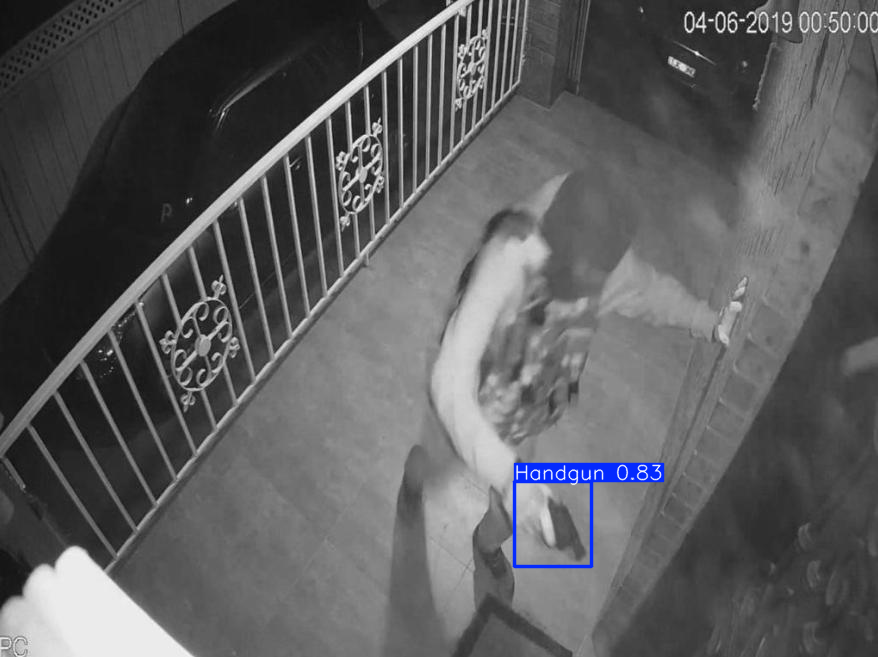




image 1/1 /content/dataset/images/val/ai_gen_handgun_309-flip.jpg: 640x640 2 Handguns, 9.8ms
Speed: 4.4ms preprocess, 9.8ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


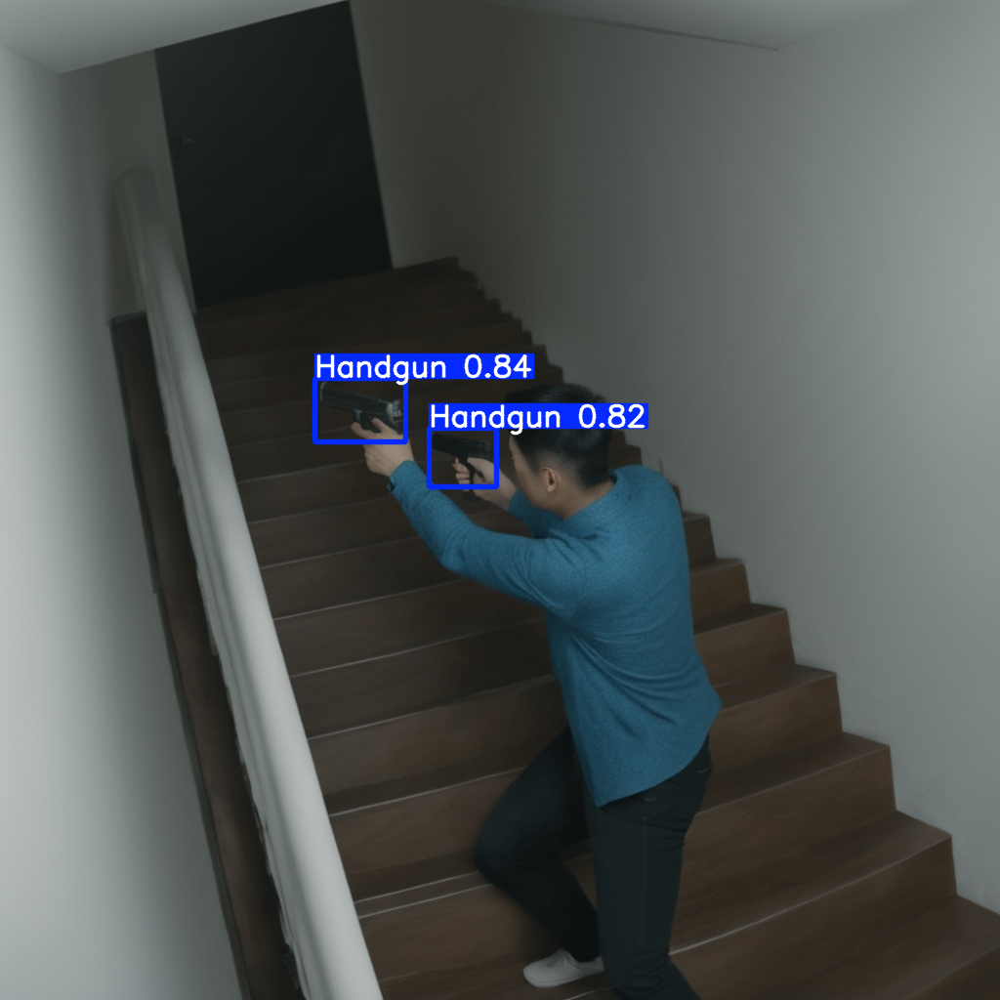



Ultralytics 8.3.15 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)


val: Scanning /content/dataset/labels/val.cache... 2649 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2649/2649 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [01:33<00:00,  2.22s/it]


                   all       2649       2797      0.989      0.964      0.979      0.782
               Handgun        929        959      0.983      0.956      0.973      0.737
                 Rifle        737        805      0.995      0.952      0.975      0.783
               Shotgun       1000       1033      0.988      0.984      0.989      0.825
Speed: 0.2ms preprocess, 2.8ms inference, 0.0ms loss, 1.9ms postprocess per image
Results saved to runs/detect/val7


Precision = 0.9887
Recall = 0.9638
map50 = 0.979
map75 = 0.8951
map50-95 = 0.7817
F1 score = 0.9761
File Size 5.94 MB


a list contains map50-95 of each category : 
	Handgun = 0.737  
	Rifle = 0.7827 
	Shotgun = 0.8252

__________ Completed __________


In [ ]:
import os
from ultralytics import YOLO

model_path = "/content/drive/MyDrive/Project_GunDetection/01-YOLOv8/YOLO8n_Gun_detection_Trained/05-Train_batch64_optimizer_AdamW_lr0_0-001_imgsz_640_momentum_0_8433/weights/best.pt"

# Load a model
model = YOLO(model_path)

# Test predict on an image
results1 = model("/content/drive/MyDrive/Project_GunDetection/00-Gun_Dataset/test_handgun.png", conf=0.5)
results1[0].show()
print('\n')
results2 = model("dataset/images/val/ai_gen_handgun_309-flip.jpg", conf=0.5)
results2[0].show()

print("\n")
# Validate the model
metrics = model.val(iou=0.5, conf=0.50, data="/content/dataset/gun_dataset.yaml", device=0, batch=64)  # no arguments needed, dataset and settings remembered

print("\n")
p = round(metrics.results_dict['metrics/precision(B)'], 4)
r = round(metrics.results_dict['metrics/recall(B)'], 4)
f1 = round(2*p*r/(p+r), 4)

print("Precision =", p)
print("Recall =", r)
print(f"map50 = {round(metrics.box.map50, 4)}")  # map50
print(f"map75 = {round(metrics.box.map75, 4)}")  # map75
print(f"map50-95 = {round(metrics.box.map, 4)}")  # map50-95
print("F1 score =", f1)

file_stats = os.stat(model_path)
print(f'File Size {round(file_stats.st_size / (1024 * 1024), 2)} MB')

print("\n")
print(f"a list contains map50-95 of each category : \n\tHandgun = {round(metrics.box.maps[0], 4)}  \n\tRifle = {round(metrics.box.maps[1], 4)} \n\tShotgun = {round(metrics.box.maps[2], 4)}")

print("\n__________ Completed __________")

# Model 06

In [ ]:
# Parameter
!cat /content/drive/MyDrive/Project_GunDetection/01-YOLOv8/YOLO8n_Gun_detection_Trained/06-Train_batch64_optimizer_AdamW_lr0_0-001_imgsz_640_weight_decay_0_0005_momentum_0_8433/args.yaml

task: detect
mode: train
model: best.pt
data: /content/dataset/gun_dataset.yaml
epochs: 100
patience: 50
batch: 64
imgsz: 640
save: true
save_period: -1
cache: false
device: 0
workers: 8
project: /content/drive/MyDrive/Gun_Detection/save_models_yolov8-0-43
name: Train_batch64_optimizer_AdamW_lr0_0-001_imgsz_640_weight_decay_0_0005_momentum_0_8433
exist_ok: false
pretrained: false
optimizer: AdamW
verbose: true
seed: 0
deterministic: true
single_cls: false
image_weights: false
rect: false
cos_lr: false
close_mosaic: 10
resume: false
min_memory: false
overlap_mask: true
mask_ratio: 4
dropout: false
val: true
split: val
save_json: false
save_hybrid: false
conf: 0.001
iou: 0.7
max_det: 300
half: false
dnn: false
plots: true
source: ultralytics/assets/
show: false
save_txt: false
save_conf: false
save_crop: false
hide_labels: false
hide_conf: false
vid_stride: 1
line_thickness: 3
visualize: false
augment: false
agnostic_nms: false
classes: null
retina_masks: false
boxes: true
format: torchs


image 1/1 /content/drive/MyDrive/Project_GunDetection/00-Gun_Dataset/test_handgun.png: 480x640 1 Handgun, 7.7ms
Speed: 2.2ms preprocess, 7.7ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


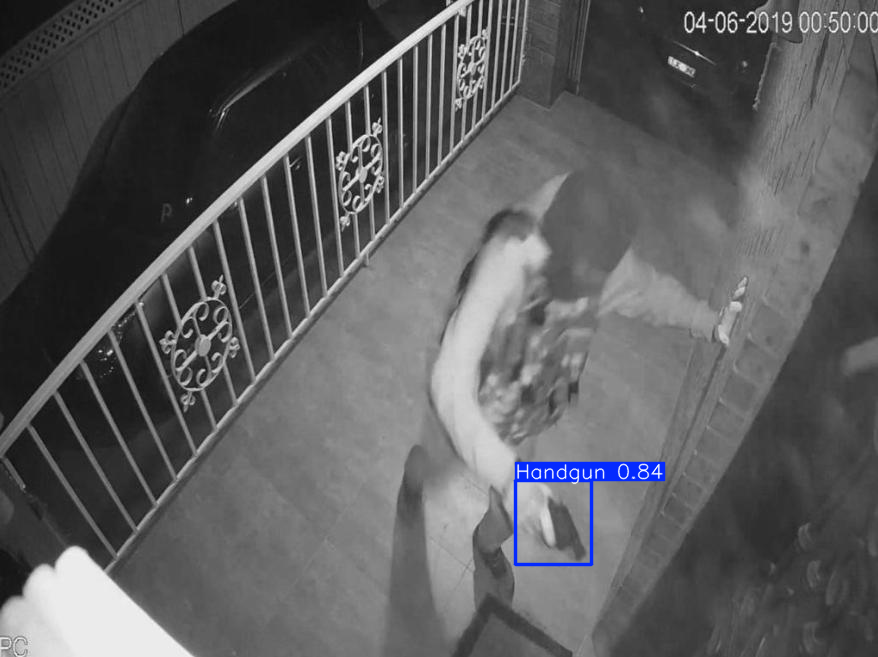




image 1/1 /content/dataset/images/val/ai_gen_handgun_309-flip.jpg: 640x640 2 Handguns, 9.2ms
Speed: 4.3ms preprocess, 9.2ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


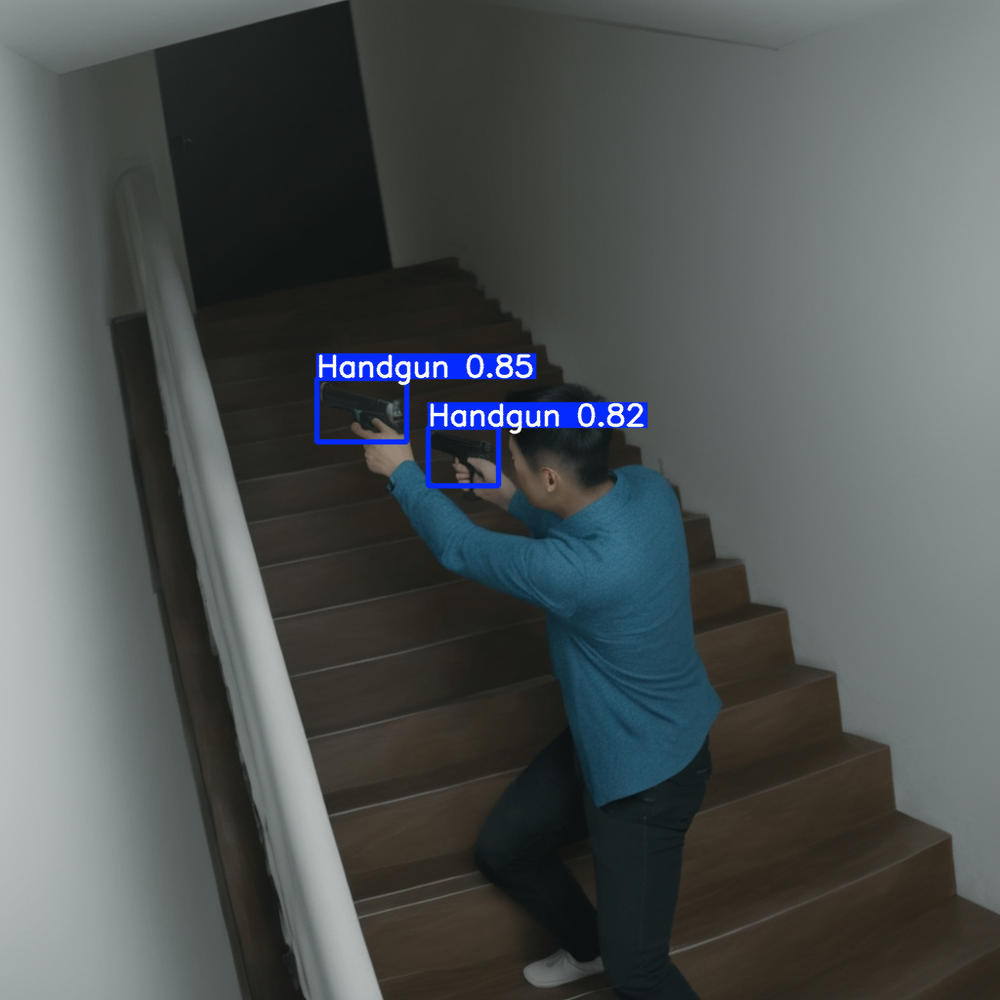



Ultralytics 8.3.15 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)


val: Scanning /content/dataset/labels/val.cache... 2649 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2649/2649 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [01:05<00:00,  1.55s/it]


                   all       2649       2797      0.987      0.966       0.98      0.781
               Handgun        929        959      0.979      0.958      0.974      0.737
                 Rifle        737        805      0.991      0.958      0.978      0.781
               Shotgun       1000       1033      0.991      0.983      0.989      0.825
Speed: 0.2ms preprocess, 2.7ms inference, 0.0ms loss, 1.7ms postprocess per image
Results saved to runs/detect/val8


Precision = 0.987
Recall = 0.9662
map50 = 0.9803
map75 = 0.8957
map50-95 = 0.7811
F1 score = 0.9765
File Size 5.94 MB


a list contains map50-95 of each category : 
	Handgun = 0.7372  
	Rifle = 0.7809 
	Shotgun = 0.8253

__________ Completed __________


In [ ]:
import os
from ultralytics import YOLO

model_path = "/content/drive/MyDrive/Project_GunDetection/01-YOLOv8/YOLO8n_Gun_detection_Trained/06-Train_batch64_optimizer_AdamW_lr0_0-001_imgsz_640_weight_decay_0_0005_momentum_0_8433/weights/best.pt"

# Load a model
model = YOLO(model_path)

# Test predict on an image
results1 = model("/content/drive/MyDrive/Project_GunDetection/00-Gun_Dataset/test_handgun.png", conf=0.5)
results1[0].show()
print('\n')
results2 = model("dataset/images/val/ai_gen_handgun_309-flip.jpg", conf=0.5)
results2[0].show()

print("\n")
# Validate the model
metrics = model.val(iou=0.5, conf=0.50, data="/content/dataset/gun_dataset.yaml", device=0, batch=64)  # no arguments needed, dataset and settings remembered

print("\n")
p = round(metrics.results_dict['metrics/precision(B)'], 4)
r = round(metrics.results_dict['metrics/recall(B)'], 4)
f1 = round(2*p*r/(p+r), 4)

print("Precision =", p)
print("Recall =", r)
print(f"map50 = {round(metrics.box.map50, 4)}")  # map50
print(f"map75 = {round(metrics.box.map75, 4)}")  # map75
print(f"map50-95 = {round(metrics.box.map, 4)}")  # map50-95
print("F1 score =", f1)

file_stats = os.stat(model_path)
print(f'File Size {round(file_stats.st_size / (1024 * 1024), 2)} MB')

print("\n")
print(f"a list contains map50-95 of each category : \n\tHandgun = {round(metrics.box.maps[0], 4)}  \n\tRifle = {round(metrics.box.maps[1], 4)} \n\tShotgun = {round(metrics.box.maps[2], 4)}")

print("\n__________ Completed __________")

# Model 07

In [ ]:
# Parameter
!cat /content/drive/MyDrive/Project_GunDetection/01-YOLOv8/YOLO8n_Gun_detection_Trained/07-Train_batch24_optimizer_AdamW_lr0_0-001_imgsz_1280/args.yaml

task: detect
mode: train
model: /content/drive/MyDrive/Gun_Detection/save_models_yolov8-0-43/Train_batch64_optimizer_AdamW_lr0_0-001
  /weights/best.pt
data: /content/dataset/Gun_Dataset/gun_dataset.yaml
epochs: 100
patience: 50
batch: 24
imgsz: 1280
save: true
save_period: -1
cache: false
device: 0
workers: 8
project: save_models_yolov8-0-43
name: 'Train_batch24_optimizer_AdamW_lr0_0-001_imgsz_1280 '
exist_ok: false
pretrained: false
optimizer: AdamW
verbose: true
seed: 0
deterministic: true
single_cls: false
image_weights: false
rect: false
cos_lr: false
close_mosaic: 10
resume: false
min_memory: false
overlap_mask: true
mask_ratio: 4
dropout: false
val: true
split: val
save_json: false
save_hybrid: false
conf: 0.001
iou: 0.7
max_det: 300
half: false
dnn: false
plots: true
source: ultralytics/assets/
show: false
save_txt: false
save_conf: false
save_crop: false
hide_labels: false
hide_conf: false
vid_stride: 1
line_thickness: 3
visualize: false
augment: false
agnostic_nms: false
clas


image 1/1 /content/drive/MyDrive/Project_GunDetection/00-Gun_Dataset/test_handgun.png: 960x1280 1 Handgun, 30.8ms
Speed: 6.7ms preprocess, 30.8ms inference, 1.5ms postprocess per image at shape (1, 3, 960, 1280)


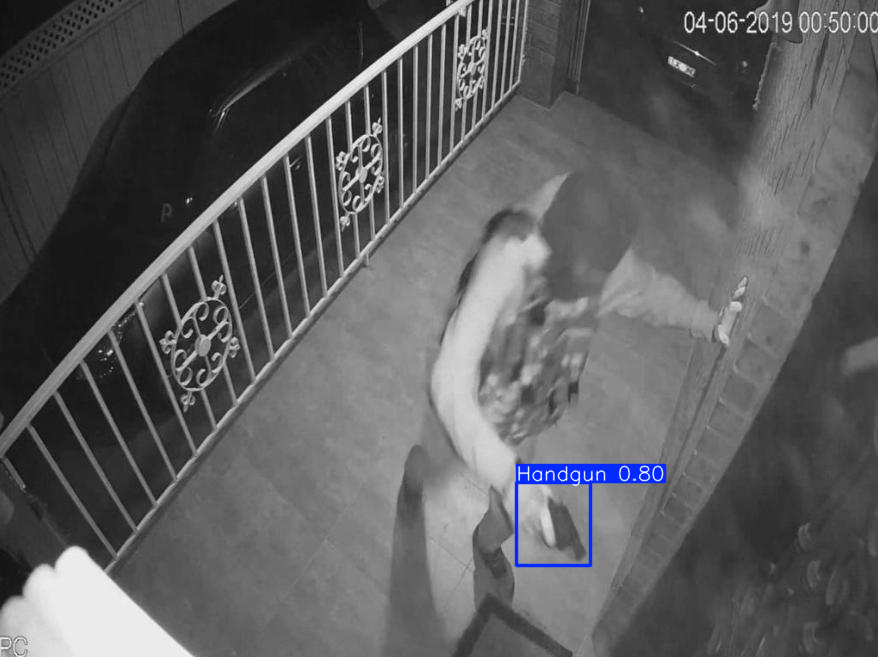




image 1/1 /content/dataset/images/val/ai_gen_handgun_309-flip.jpg: 1280x1280 2 Handguns, 20.7ms
Speed: 12.8ms preprocess, 20.7ms inference, 1.9ms postprocess per image at shape (1, 3, 1280, 1280)


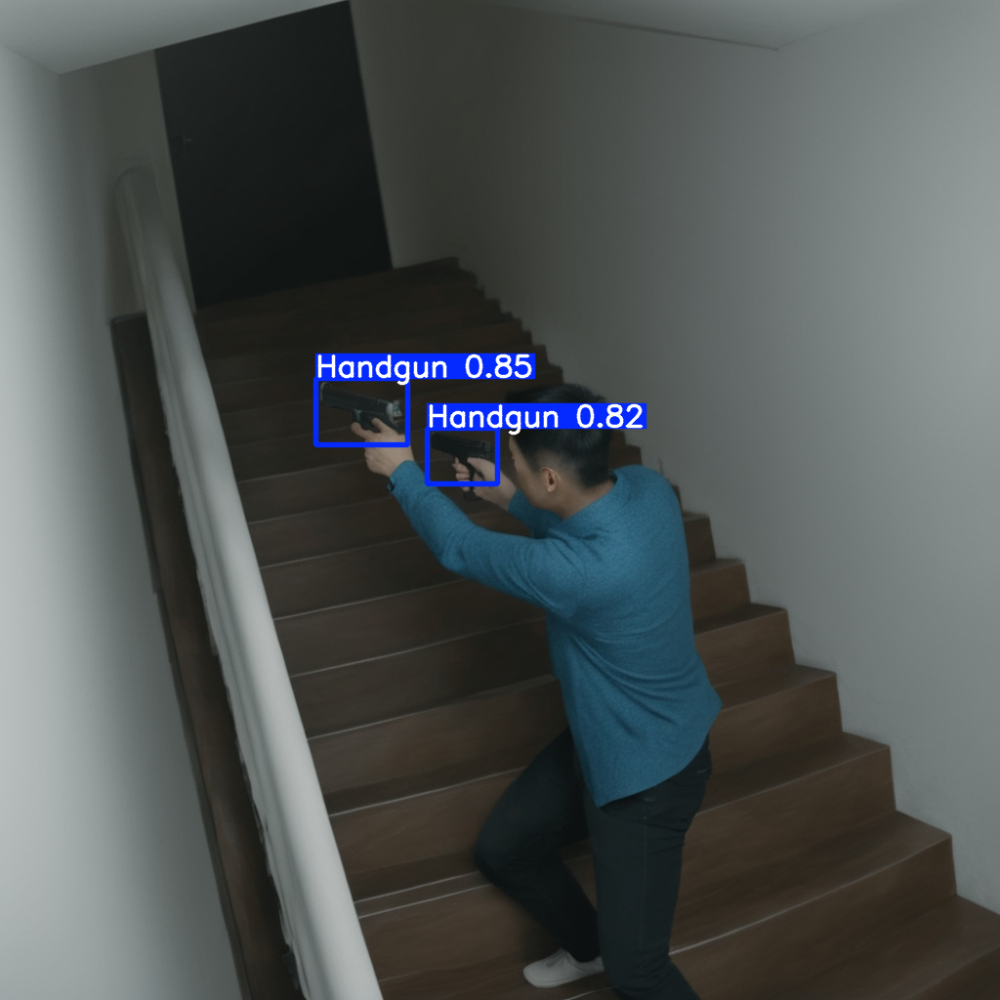



Ultralytics 8.3.15 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)


val: Scanning /content/dataset/labels/val.cache... 2649 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2649/2649 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [01:34<00:00,  2.25s/it]


                   all       2649       2797      0.986      0.978      0.987      0.789
               Handgun        929        959       0.98      0.975      0.983      0.754
                 Rifle        737        805      0.989      0.973      0.986      0.797
               Shotgun       1000       1033       0.99      0.987      0.991      0.816
Speed: 3.1ms preprocess, 9.9ms inference, 0.0ms loss, 1.8ms postprocess per image
Results saved to runs/detect/val11


Precision = 0.9862
Recall = 0.9785
map50 = 0.9867
map75 = 0.9093
map50-95 = 0.789
F1 score = 0.9823
File Size 5.99 MB


a list contains map50-95 of each category : 
	Handgun = 0.7536  
	Rifle = 0.7974 
	Shotgun = 0.8159

__________ Completed __________


In [ ]:
import os
from ultralytics import YOLO

model_path = "/content/drive/MyDrive/Project_GunDetection/01-YOLOv8/YOLO8n_Gun_detection_Trained/07-Train_batch24_optimizer_AdamW_lr0_0-001_imgsz_1280/weights/best.pt"

# Load a model
model = YOLO(model_path)

# Test predict on an image
results1 = model("/content/drive/MyDrive/Project_GunDetection/00-Gun_Dataset/test_handgun.png", conf=0.5, imgsz=1280)
results1[0].show()
print('\n')
results2 = model("dataset/images/val/ai_gen_handgun_309-flip.jpg", conf=0.5,  imgsz=1280)
results2[0].show()

print("\n")
# Validate the model
metrics = model.val(iou=0.5, conf=0.50, data="/content/dataset/gun_dataset.yaml", device=0, batch=64)  # no arguments needed, dataset and settings remembered

print("\n")
p = round(metrics.results_dict['metrics/precision(B)'], 4)
r = round(metrics.results_dict['metrics/recall(B)'], 4)
f1 = round(2*p*r/(p+r), 4)

print("Precision =", p)
print("Recall =", r)
print(f"map50 = {round(metrics.box.map50, 4)}")  # map50
print(f"map75 = {round(metrics.box.map75, 4)}")  # map75
print(f"map50-95 = {round(metrics.box.map, 4)}")  # map50-95
print("F1 score =", f1)

file_stats = os.stat(model_path)
print(f'File Size {round(file_stats.st_size / (1024 * 1024), 2)} MB')

print("\n")
print(f"a list contains map50-95 of each category : \n\tHandgun = {round(metrics.box.maps[0], 4)}  \n\tRifle = {round(metrics.box.maps[1], 4)} \n\tShotgun = {round(metrics.box.maps[2], 4)}")

print("\n__________ Completed __________")

# Model 08

In [ ]:
# Parameter
!cat /content/drive/MyDrive/Project_GunDetection/01-YOLOv8/YOLO8n_Gun_detection_Trained/08-Train_batch24_optimizer_AdamW_lr0_0-001_imgsz_1280_weight_decay_0.0015_momentum_0.98385/args.yaml

task: detect
mode: train
model: /content/drive/MyDrive/Project_GunDetection/01-YOLOv8/09-Train_batch24_optimizer_AdamW_lr0_0-001_imgsz_1280_weight_decay_0.0015_momentum_0.98385/weights/last.pt
data: /content/dataset/gun_dataset.yaml
epochs: 100
patience: 50
batch: 24
imgsz: 1280
save: true
save_period: -1
cache: false
device: 0
workers: 8
project: /content/drive/MyDrive/Project_GunDetection/01-YOLOv8
name: 09-Train_batch24_optimizer_AdamW_lr0_0-001_imgsz_1280_weight_decay_0.0015_momentum_0.98385
exist_ok: false
pretrained: false
optimizer: AdamW
verbose: true
seed: 0
deterministic: true
single_cls: false
image_weights: false
rect: false
cos_lr: false
close_mosaic: 10
resume: false
min_memory: false
overlap_mask: true
mask_ratio: 4
dropout: false
val: true
split: val
save_json: false
save_hybrid: false
conf: 0.001
iou: 0.7
max_det: 300
half: false
dnn: false
plots: true
source: ultralytics/assets/
show: false
save_txt: false
save_conf: false
save_crop: false
hide_labels: false
hide_conf


image 1/1 /content/drive/MyDrive/Project_GunDetection/00-Gun_Dataset/test_handgun.png: 960x1280 1 Handgun, 15.9ms
Speed: 7.0ms preprocess, 15.9ms inference, 1.4ms postprocess per image at shape (1, 3, 960, 1280)


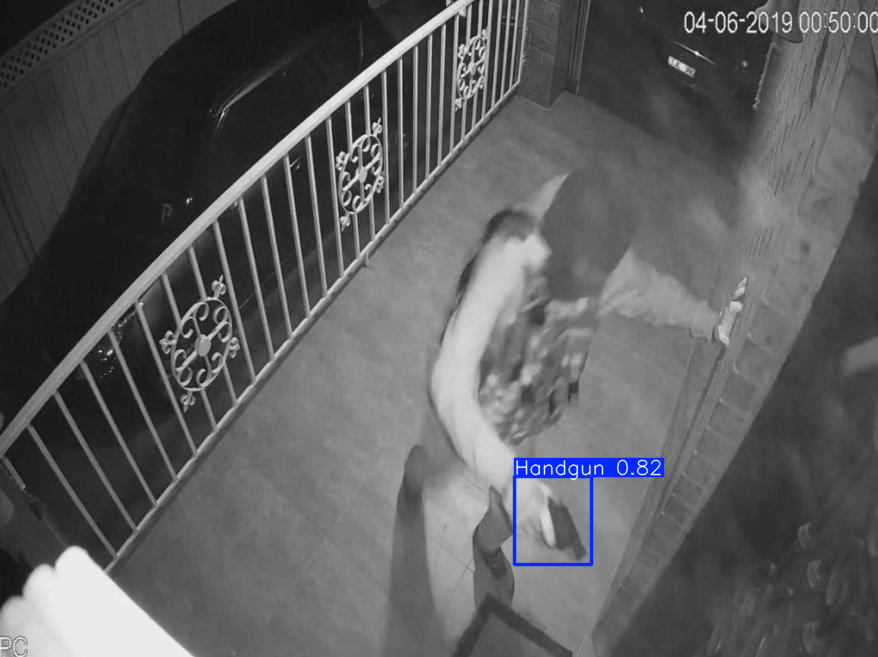




image 1/1 /content/dataset/images/val/ai_gen_handgun_309-flip.jpg: 1280x1280 2 Handguns, 20.3ms
Speed: 12.9ms preprocess, 20.3ms inference, 1.8ms postprocess per image at shape (1, 3, 1280, 1280)


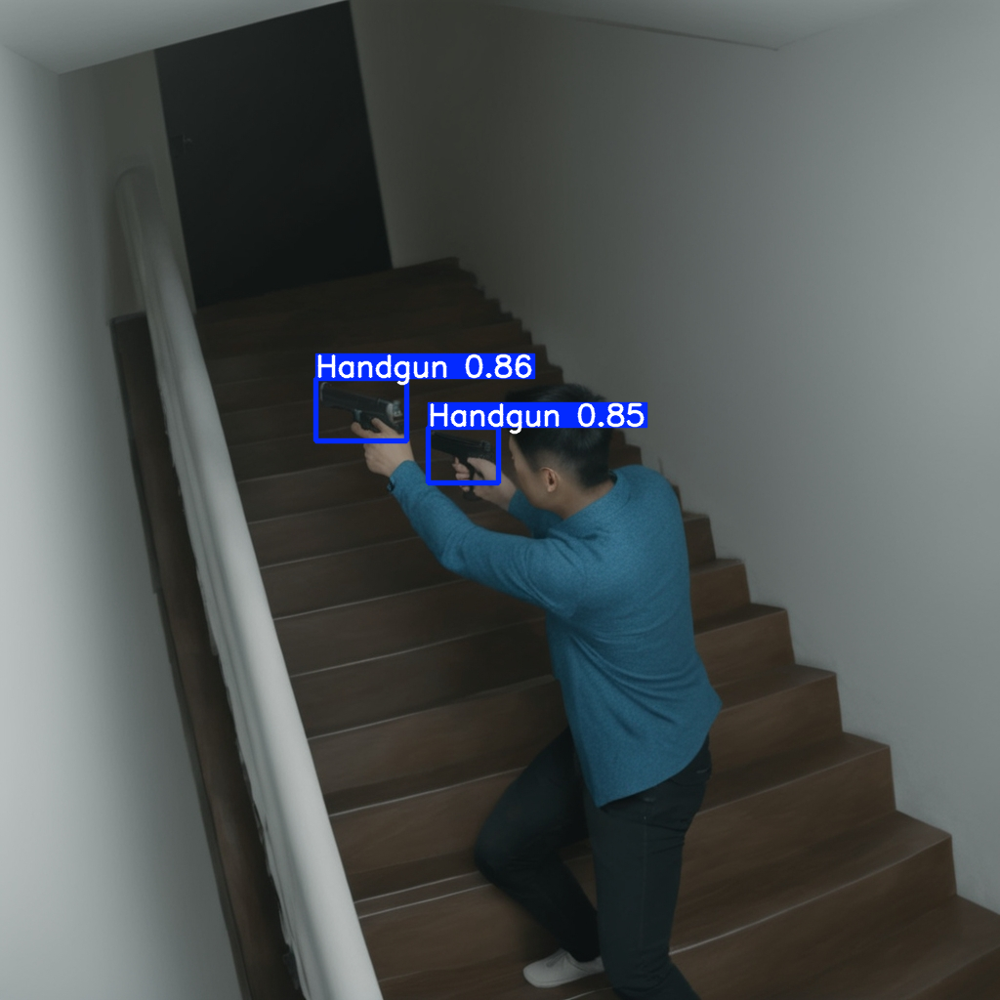



Ultralytics 8.3.15 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)


val: Scanning /content/dataset/labels/val.cache... 2649 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2649/2649 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [01:36<00:00,  2.29s/it]


                   all       2649       2797      0.988      0.977      0.986      0.788
               Handgun        929        959      0.981      0.972      0.981      0.748
                 Rifle        737        805       0.99      0.974      0.987      0.798
               Shotgun       1000       1033      0.994      0.986       0.99      0.817
Speed: 2.6ms preprocess, 10.0ms inference, 0.0ms loss, 2.2ms postprocess per image
Results saved to runs/detect/val12


Precision = 0.9881
Recall = 0.9773
map50 = 0.9862
map75 = 0.909
map50-95 = 0.7878
F1 score = 0.9827
File Size 5.99 MB


a list contains map50-95 of each category : 
	Handgun = 0.7484  
	Rifle = 0.7976 
	Shotgun = 0.8173

__________ Completed __________


In [ ]:
import os
from ultralytics import YOLO

model_path = "/content/drive/MyDrive/Project_GunDetection/01-YOLOv8/YOLO8n_Gun_detection_Trained/08-Train_batch24_optimizer_AdamW_lr0_0-001_imgsz_1280_weight_decay_0.0015_momentum_0.98385/weights/best.pt"

# Load a model
model = YOLO(model_path)

# Test predict on an image
results1 = model("/content/drive/MyDrive/Project_GunDetection/00-Gun_Dataset/test_handgun.png", conf=0.5, imgsz=1280)
results1[0].show()
print('\n')
results2 = model("dataset/images/val/ai_gen_handgun_309-flip.jpg", conf=0.5,  imgsz=1280)
results2[0].show()

print("\n")
# Validate the model
metrics = model.val(iou=0.5, conf=0.50, data="/content/dataset/gun_dataset.yaml", device=0, batch=64)  # no arguments needed, dataset and settings remembered

print("\n")
p = round(metrics.results_dict['metrics/precision(B)'], 4)
r = round(metrics.results_dict['metrics/recall(B)'], 4)
f1 = round(2*p*r/(p+r), 4)

print("Precision =", p)
print("Recall =", r)
print(f"map50 = {round(metrics.box.map50, 4)}")  # map50
print(f"map75 = {round(metrics.box.map75, 4)}")  # map75
print(f"map50-95 = {round(metrics.box.map, 4)}")  # map50-95
print("F1 score =", f1)

file_stats = os.stat(model_path)
print(f'File Size {round(file_stats.st_size / (1024 * 1024), 2)} MB')

print("\n")
print(f"a list contains map50-95 of each category : \n\tHandgun = {round(metrics.box.maps[0], 4)}  \n\tRifle = {round(metrics.box.maps[1], 4)} \n\tShotgun = {round(metrics.box.maps[2], 4)}")

print("\n__________ Completed __________")

# Model 09

In [ ]:
# Parameter
!cat /content/drive/MyDrive/Project_GunDetection/01-YOLOv8/YOLO8n_Gun_detection_Trained/09-Train_batch32_optimizer_AdamW_lr0_0-001_imgsz_1280_weight_decay_0.0005_momentum_0.8433/args.yaml

task: detect
mode: train
model: /content/drive/MyDrive/Project_GunDetection/01-YOLOv8/10-Train_batch32_optimizer_AdamW_lr0_0-001_imgsz_1280_weight_decay_0.0005_momentum_0.84332/weights/last.pt
data: /content/dataset/gun_dataset.yaml
epochs: 100
patience: 50
batch: 32
imgsz: 1280
save: true
save_period: -1
cache: false
device: 0
workers: 8
project: /content/drive/MyDrive/Project_GunDetection/01-YOLOv8
name: 10-Train_batch32_optimizer_AdamW_lr0_0-001_imgsz_1280_weight_decay_0.0005_momentum_0.8433
exist_ok: false
pretrained: false
optimizer: AdamW
verbose: true
seed: 0
deterministic: true
single_cls: false
image_weights: false
rect: false
cos_lr: false
close_mosaic: 10
resume: false
min_memory: false
overlap_mask: true
mask_ratio: 4
dropout: false
val: true
split: val
save_json: false
save_hybrid: false
conf: 0.001
iou: 0.7
max_det: 300
half: false
dnn: false
plots: true
source: ultralytics/assets/
show: false
save_txt: false
save_conf: false
save_crop: false
hide_labels: false
hide_conf:


image 1/1 /content/drive/MyDrive/Project_GunDetection/00-Gun_Dataset/test_handgun.png: 960x1280 1 Handgun, 15.8ms
Speed: 6.9ms preprocess, 15.8ms inference, 1.4ms postprocess per image at shape (1, 3, 960, 1280)


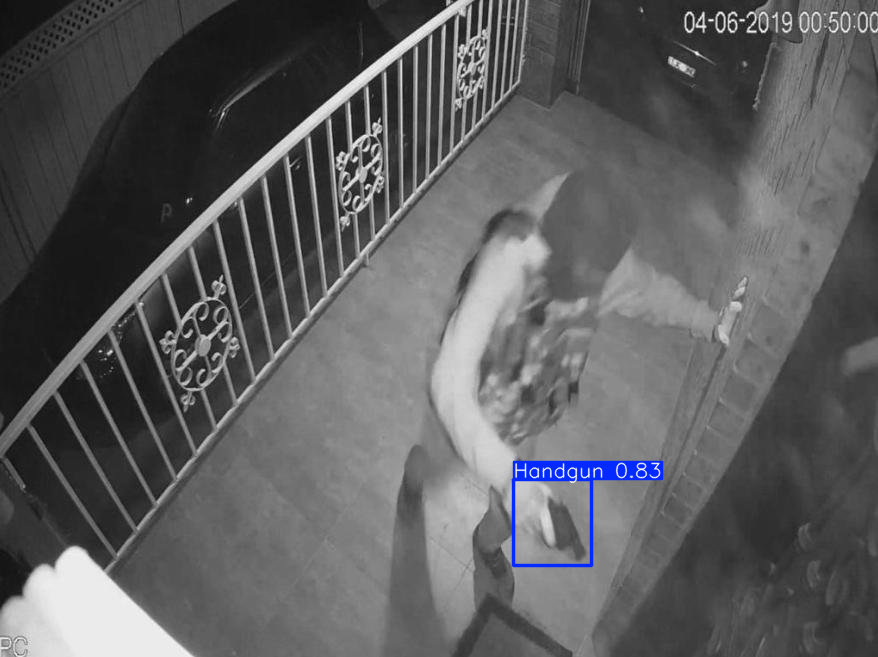




image 1/1 /content/dataset/images/val/ai_gen_handgun_309-flip.jpg: 1280x1280 2 Handguns, 20.5ms
Speed: 13.8ms preprocess, 20.5ms inference, 1.6ms postprocess per image at shape (1, 3, 1280, 1280)


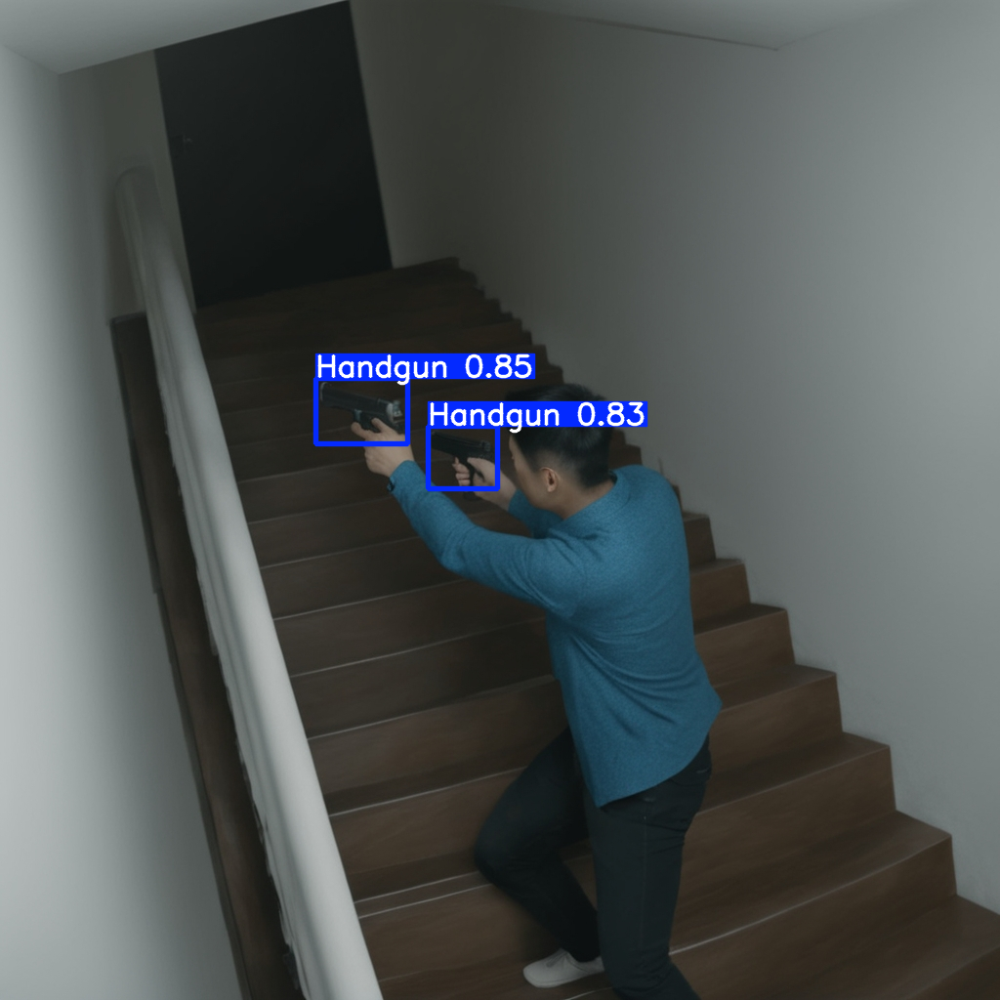



Ultralytics 8.3.15 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)


val: Scanning /content/dataset/labels/val.cache... 2649 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2649/2649 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [01:52<00:00,  2.68s/it]


                   all       2649       2797      0.985       0.98      0.987       0.79
               Handgun        929        959      0.976      0.973      0.981      0.749
                 Rifle        737        805       0.99      0.976      0.987      0.799
               Shotgun       1000       1033       0.99      0.989      0.992      0.821
Speed: 2.9ms preprocess, 10.0ms inference, 0.0ms loss, 2.2ms postprocess per image
Results saved to runs/detect/val13


Precision = 0.9854
Recall = 0.9795
map50 = 0.987
map75 = 0.9125
map50-95 = 0.7897
F1 score = 0.9824
File Size 6.01 MB


a list contains map50-95 of each category : 
	Handgun = 0.7494  
	Rifle = 0.7986 
	Shotgun = 0.821

__________ Completed __________


In [ ]:
import os
from ultralytics import YOLO

model_path = "/content/drive/MyDrive/Project_GunDetection/01-YOLOv8/YOLO8n_Gun_detection_Trained/09-Train_batch32_optimizer_AdamW_lr0_0-001_imgsz_1280_weight_decay_0.0005_momentum_0.8433/weights/best.pt"

# Load a model
model = YOLO(model_path)

# Test predict on an image
results1 = model("/content/drive/MyDrive/Project_GunDetection/00-Gun_Dataset/test_handgun.png", conf=0.5, imgsz=1280)
results1[0].show()
print('\n')
results2 = model("dataset/images/val/ai_gen_handgun_309-flip.jpg", conf=0.5,  imgsz=1280)
results2[0].show()

print("\n")
# Validate the model
metrics = model.val(iou=0.5, conf=0.50, data="/content/dataset/gun_dataset.yaml", device=0, batch=64)  # no arguments needed, dataset and settings remembered

print("\n")
p = round(metrics.results_dict['metrics/precision(B)'], 4)
r = round(metrics.results_dict['metrics/recall(B)'], 4)
f1 = round(2*p*r/(p+r), 4)

print("Precision =", p)
print("Recall =", r)
print(f"map50 = {round(metrics.box.map50, 4)}")  # map50
print(f"map75 = {round(metrics.box.map75, 4)}")  # map75
print(f"map50-95 = {round(metrics.box.map, 4)}")  # map50-95
print("F1 score =", f1)

file_stats = os.stat(model_path)
print(f'File Size {round(file_stats.st_size / (1024 * 1024), 2)} MB')

print("\n")
print(f"a list contains map50-95 of each category : \n\tHandgun = {round(metrics.box.maps[0], 4)}  \n\tRifle = {round(metrics.box.maps[1], 4)} \n\tShotgun = {round(metrics.box.maps[2], 4)}")

print("\n__________ Completed __________")

# Model 10

In [ ]:
# Parameter
!cat /content/drive/MyDrive/Project_GunDetection/01-YOLOv8/YOLO8n_Gun_detection_Trained/10-L4_GPU_Train_batch32_optimizer_AdamW_lr0_0-001_imgsz_1280_weight_decay_0.0005_momentum_0.937/args.yaml

task: detect
mode: train
model: /content/drive/MyDrive/Project_GunDetection/01-YOLOv8/10-L4_GPU_Train_batch32_optimizer_AdamW_lr0_0-001_imgsz_1280_weight_decay_0.0005_momentum_0.937/weights/last.pt
data: /content/dataset/gun_dataset.yaml
epochs: 100
patience: 50
batch: 32
imgsz: 1280
save: true
save_period: -1
cache: false
device: 0
workers: 8
project: /content/drive/MyDrive/Project_GunDetection/01-YOLOv8
name: 10-L4_GPU_Train_batch32_optimizer_AdamW_lr0_0-001_imgsz_1280_weight_decay_0.0005_momentum_0.937
exist_ok: false
pretrained: false
optimizer: AdamW
verbose: true
seed: 0
deterministic: true
single_cls: false
image_weights: false
rect: false
cos_lr: false
close_mosaic: 10
resume: false
min_memory: false
overlap_mask: true
mask_ratio: 4
dropout: false
val: true
split: val
save_json: false
save_hybrid: false
conf: 0.001
iou: 0.7
max_det: 300
half: false
dnn: false
plots: true
source: ultralytics/assets/
show: false
save_txt: false
save_conf: false
save_crop: false
hide_labels: false


image 1/1 /content/drive/MyDrive/Project_GunDetection/00-Gun_Dataset/test_handgun.png: 960x1280 1 Handgun, 15.9ms
Speed: 10.2ms preprocess, 15.9ms inference, 1.4ms postprocess per image at shape (1, 3, 960, 1280)


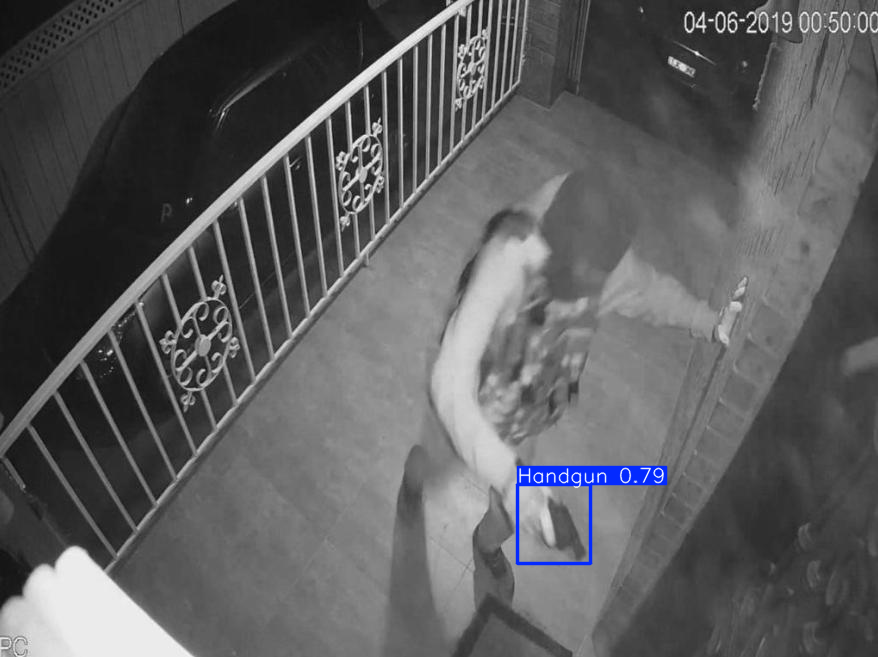




image 1/1 /content/dataset/images/val/ai_gen_handgun_309-flip.jpg: 1280x1280 2 Handguns, 21.9ms
Speed: 21.9ms preprocess, 21.9ms inference, 2.1ms postprocess per image at shape (1, 3, 1280, 1280)


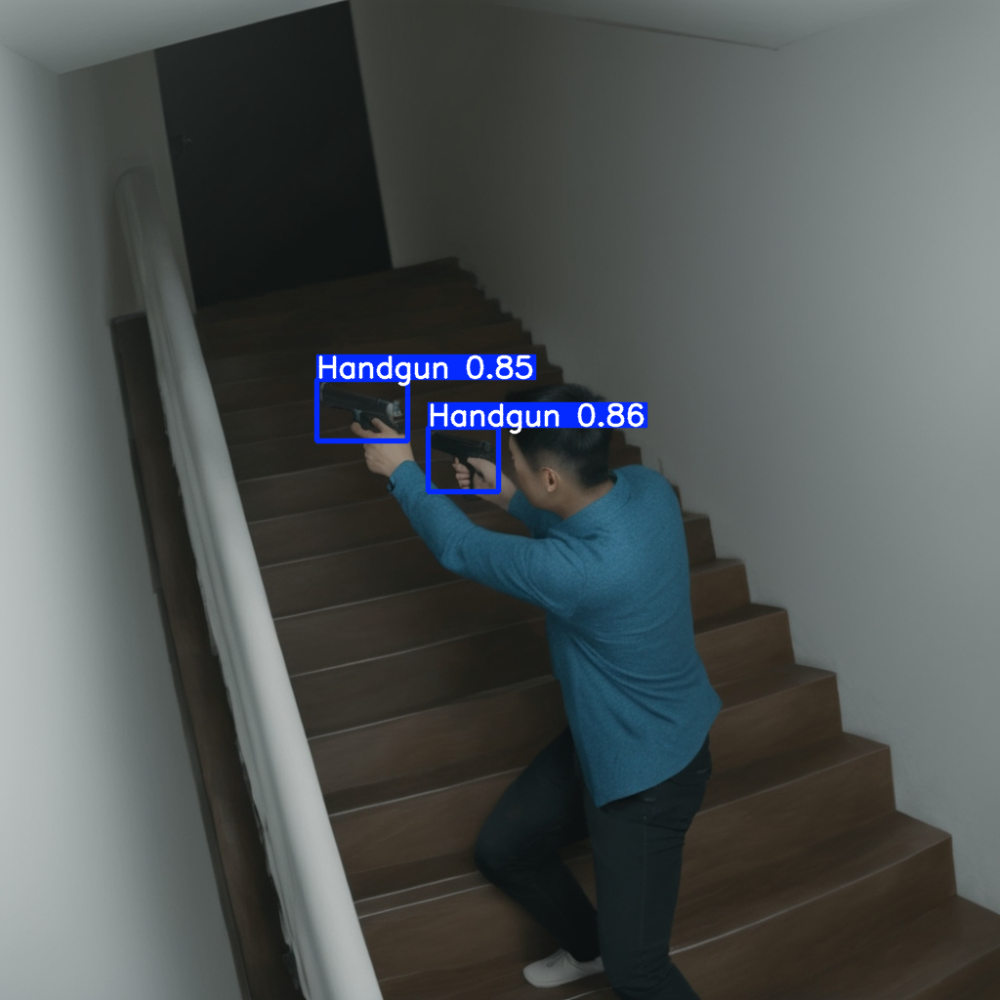



Ultralytics 8.3.15 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)


val: Scanning /content/dataset/labels/val.cache... 2649 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2649/2649 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [06:08<00:00,  8.79s/it]


                   all       2649       2797      0.986      0.975      0.984      0.782
               Handgun        929        959       0.98      0.971      0.979      0.746
                 Rifle        737        805       0.99       0.97      0.984      0.794
               Shotgun       1000       1033      0.987      0.985      0.989      0.807
Speed: 2.6ms preprocess, 10.3ms inference, 0.0ms loss, 4.1ms postprocess per image
Results saved to runs/detect/val14


Precision = 0.9857
Recall = 0.9752
map50 = 0.9842
map75 = 0.9029
map50-95 = 0.7823
F1 score = 0.9804
File Size 6.01 MB


a list contains map50-95 of each category : 
	Handgun = 0.7457  
	Rifle = 0.7939 
	Shotgun = 0.8074

__________ Completed __________


In [ ]:
import os
from ultralytics import YOLO

model_path = "/content/drive/MyDrive/Project_GunDetection/01-YOLOv8/YOLO8n_Gun_detection_Trained/10-L4_GPU_Train_batch32_optimizer_AdamW_lr0_0-001_imgsz_1280_weight_decay_0.0005_momentum_0.937/weights/best.pt"

# Load a model
model = YOLO(model_path)

# Test predict on an image
results1 = model("/content/drive/MyDrive/Project_GunDetection/00-Gun_Dataset/test_handgun.png", conf=0.5, imgsz=1280)
results1[0].show()
print('\n')
results2 = model("dataset/images/val/ai_gen_handgun_309-flip.jpg", conf=0.5,  imgsz=1280)
results2[0].show()

print("\n")
# Validate the model
metrics = model.val(iou=0.5, conf=0.50, data="/content/dataset/gun_dataset.yaml", device=0, batch=64)  # no arguments needed, dataset and settings remembered

print("\n")
p = round(metrics.results_dict['metrics/precision(B)'], 4)
r = round(metrics.results_dict['metrics/recall(B)'], 4)
f1 = round(2*p*r/(p+r), 4)

print("Precision =", p)
print("Recall =", r)
print(f"map50 = {round(metrics.box.map50, 4)}")  # map50
print(f"map75 = {round(metrics.box.map75, 4)}")  # map75
print(f"map50-95 = {round(metrics.box.map, 4)}")  # map50-95
print("F1 score =", f1)

file_stats = os.stat(model_path)
print(f'File Size {round(file_stats.st_size / (1024 * 1024), 2)} MB')

print("\n")
print(f"a list contains map50-95 of each category : \n\tHandgun = {round(metrics.box.maps[0], 4)}  \n\tRifle = {round(metrics.box.maps[1], 4)} \n\tShotgun = {round(metrics.box.maps[2], 4)}")

print("\n__________ Completed __________")

# Model- YOLOv8S

In [ ]:
# Parameter
!cat /content/drive/MyDrive/Project_GunDetection/01-YOLOv8/YOLOv8S_Gun_detection_Trained/save_models_yolov8s/Train_YOLOv8s_100_epoch_AdamW/args.yaml

task: detect
mode: train
model: yolov8s.pt
data: ./Gun_Dataset/gun_dataset.yaml
epochs: 100
patience: 50
batch: 16
imgsz: 640
save: true
save_period: -1
cache: false
device: 0
workers: 8
project: save_models_yolov8s
name: Train_YOLOv8s_100_epoch_AdamW
exist_ok: false
pretrained: false
optimizer: AdamW
verbose: true
seed: 0
deterministic: true
single_cls: false
image_weights: false
rect: false
cos_lr: false
close_mosaic: 10
resume: false
min_memory: false
overlap_mask: true
mask_ratio: 4
dropout: false
val: true
split: val
save_json: false
save_hybrid: false
conf: 0.001
iou: 0.7
max_det: 300
half: false
dnn: false
plots: true
source: ultralytics/assets/
show: false
save_txt: false
save_conf: false
save_crop: false
hide_labels: false
hide_conf: false
vid_stride: 1
line_thickness: 3
visualize: false
augment: false
agnostic_nms: false
classes: null
retina_masks: false
boxes: true
format: torchscript
keras: false
optimize: false
int8: false
dynamic: false
simplify: false
opset: null
workspa


image 1/1 /content/drive/MyDrive/Project_GunDetection/00-Gun_Dataset/test_handgun.png: 480x640 1 Handgun, 66.3ms
Speed: 3.5ms preprocess, 66.3ms inference, 2.1ms postprocess per image at shape (1, 3, 480, 640)


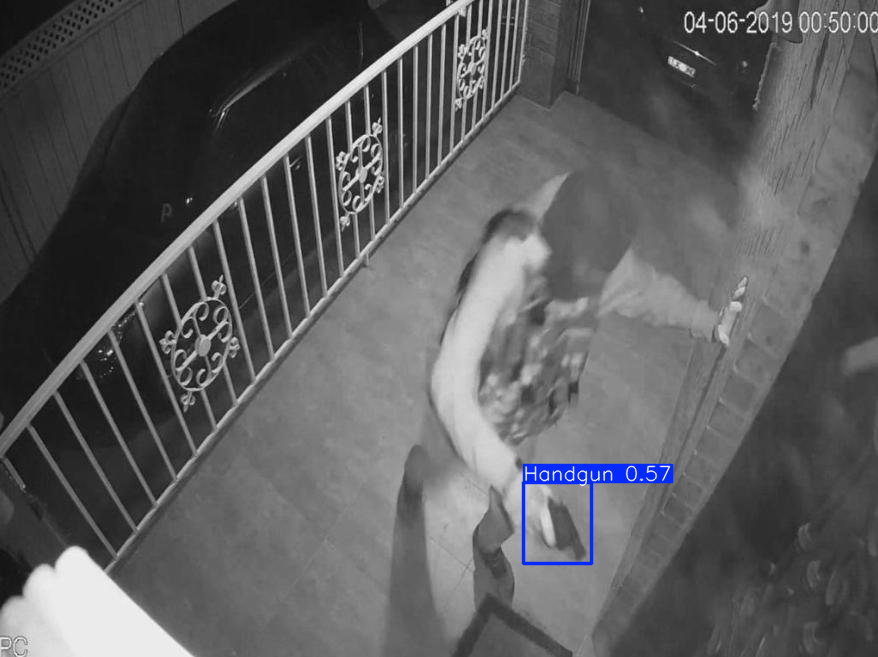




image 1/1 /content/dataset/images/val/ai_gen_handgun_309-flip.jpg: 640x640 2 Handguns, 17.3ms
Speed: 4.5ms preprocess, 17.3ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


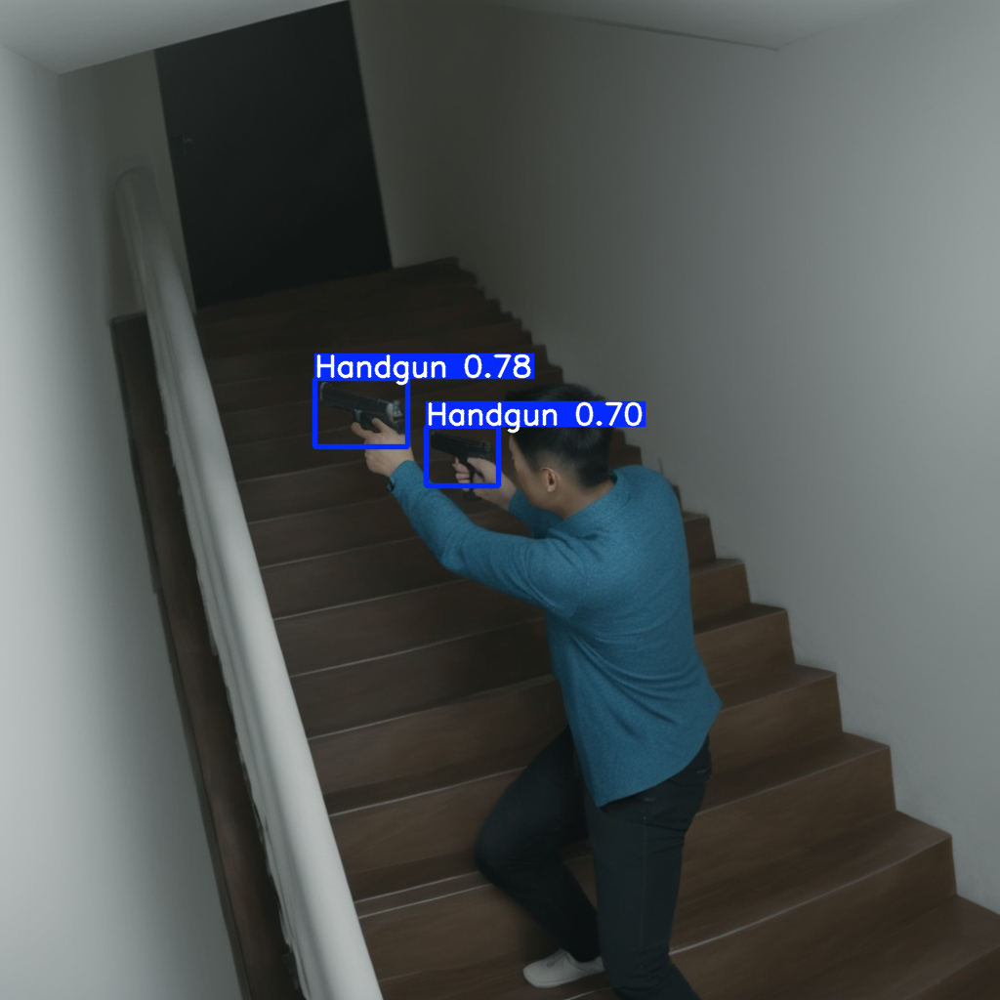



Ultralytics 8.3.15 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)


100%|██████████| 755k/755k [00:00<00:00, 24.5MB/s]
val: Scanning /content/dataset/labels/val... 2649 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2649/2649 [00:03<00:00, 730.24it/s] 


val: New cache created: /content/dataset/labels/val.cache


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 42/42 [01:05<00:00,  1.56s/it]


                   all       2649       2797       0.98      0.944      0.968      0.765
               Handgun        929        959      0.969      0.928      0.958      0.723
                 Rifle        737        805      0.987      0.929      0.963      0.766
               Shotgun       1000       1033      0.983      0.974      0.984      0.807
Speed: 0.4ms preprocess, 6.1ms inference, 0.0ms loss, 1.5ms postprocess per image
Results saved to runs/detect/val


Precision = 0.9799
Recall = 0.9437
map50 = 0.9684
map75 = 0.8702
map50-95 = 0.7653
F1 score = 0.9615
File Size 21.45 MB


a list contains map50-95 of each category : 
	Handgun = 0.7225  
	Rifle = 0.7658 
	Shotgun = 0.8075

__________ Completed __________


In [ ]:
import os
from ultralytics import YOLO

model_path = "/content/drive/MyDrive/Project_GunDetection/01-YOLOv8/YOLOv8S_Gun_detection_Trained/save_models_yolov8s/Train_YOLOv8s_100_epoch_AdamW/weights/best.pt"

# Load a model
model = YOLO(model_path)

# Test predict on an image
results1 = model("/content/drive/MyDrive/Project_GunDetection/00-Gun_Dataset/test_handgun.png", conf=0.5)
results1[0].show()
print('\n')
results2 = model("dataset/images/val/ai_gen_handgun_309-flip.jpg", conf=0.5)
results2[0].show()

print("\n")
# Validate the model
metrics = model.val(iou=0.5, conf=0.50, data="/content/dataset/gun_dataset.yaml", device=0, batch=64)  # no arguments needed, dataset and settings remembered

print("\n")
p = round(metrics.results_dict['metrics/precision(B)'], 4)
r = round(metrics.results_dict['metrics/recall(B)'], 4)
f1 = round(2*p*r/(p+r), 4)

print("Precision =", p)
print("Recall =", r)
print(f"map50 = {round(metrics.box.map50, 4)}")  # map50
print(f"map75 = {round(metrics.box.map75, 4)}")  # map75
print(f"map50-95 = {round(metrics.box.map, 4)}")  # map50-95
print("F1 score =", f1)

file_stats = os.stat(model_path)
print(f'File Size {round(file_stats.st_size / (1024 * 1024), 2)} MB')

print("\n")
print(f"a list contains map50-95 of each category : \n\tHandgun = {round(metrics.box.maps[0], 4)}  \n\tRifle = {round(metrics.box.maps[1], 4)} \n\tShotgun = {round(metrics.box.maps[2], 4)}")

print("\n__________ Completed __________")